In [1183]:
import scanpy as sc

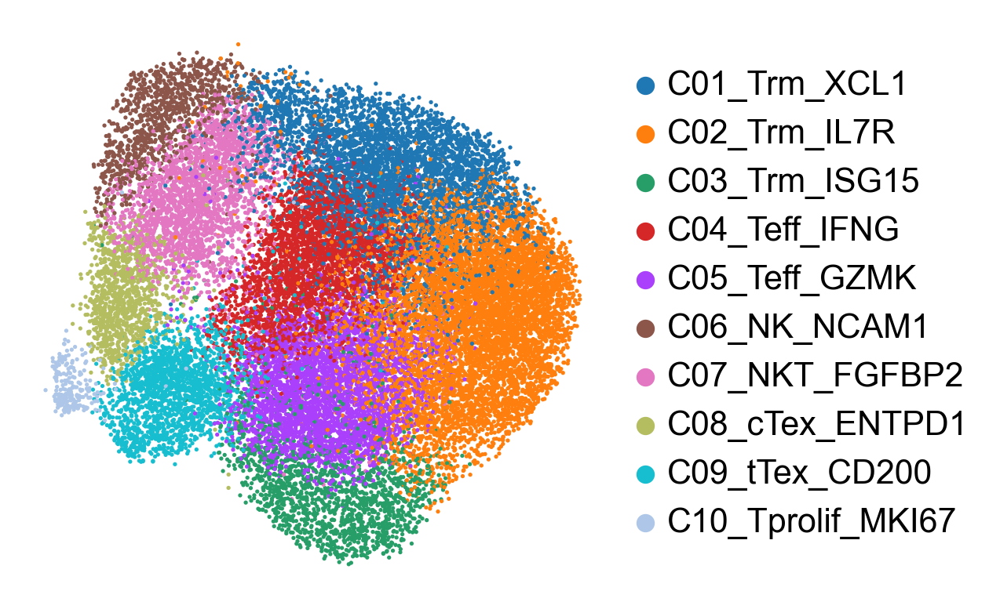

In [764]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.umap(adata_CD8T, color=['anno-CD8T-har'], show=False, ax=ax, title='', size=10)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
# ax.legend(  handletextpad=0.5, frameon=False,
#                     borderpad=0.6,
#                     columnspacing=1.3,
#                     handlelength=0.65, fontsize=12)
fig.savefig(f"figure-1.23/4b-anno_CD8T.png", dpi=400, bbox_inches='tight')

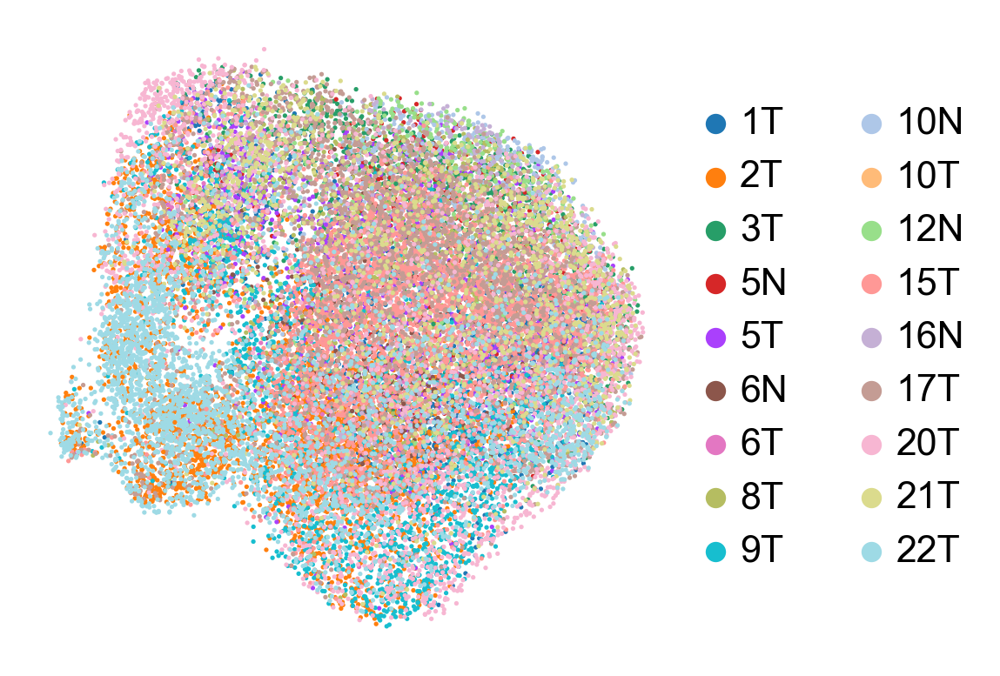

In [754]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.umap(adata_CD8T, color=['batch'], show=False, ax=ax, title='', size=10)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
# ax.legend(  handletextpad=0.5, frameon=False,
#                     borderpad=0.6,
#                     columnspacing=1.3,
#                     handlelength=0.65, fontsize=12)
fig.savefig(f"figure-1.23/4b-anno_CD8T.png", dpi=400, bbox_inches='tight')

In [767]:
import pandas as pd
import numpy as np
from matplotlib import ticker
plt.rcParams["font.sans-serif"] = ["Arial"]
plt.rcParams["axes.unicode_minus"] = False
plt.rcParams["font.size"] = 14
def propPlot(age_df, barlabels, ax, colors=sc.pl.palettes.default_20, xlabel='Patient ID', show_y=True, xrotate=90):
    all_df = age_df.sum(axis=1)
    age_normdf = pd.DataFrame([age_df.loc[i,:]/all_df[i] for i in barlabels], index=barlabels)
    age_cumdf = pd.DataFrame([np.cumsum(age_normdf.loc[i,:]) for i in barlabels], index=barlabels)
    norm_gdfs = age_normdf
    cum_gdfs = age_cumdf
    for i, col in enumerate(age_df.columns):
        height = norm_gdfs[col]
        starts = cum_gdfs[col] - height
        rects = ax.bar(barlabels, height, bottom=starts, width=0.9, color=colors[i], edgecolor='white', linewidth=0.5,
                        label=col, alpha=1)
    
        # ax.bar_label(rects,age_df.loc[:, col], label_type='center', color='lightgrey', fontsize=14)
    ax.legend( bbox_to_anchor=(1, -0.3), 
              handletextpad=0.5, frameon=False,
                          borderpad=0.4,
                          columnspacing=1,
                          handlelength=0.65,
              loc='lower left')
    if show_y:
        ax.yaxis.set_major_formatter(ticker.PercentFormatter(xmax=1,decimals=0))
        ax.set_ylabel('Cell proportions')
    else:
        ax.yaxis.set_visible(False)
        ax.spines.left.set_visible(False)
    ax.set_xlabel(xlabel)
    ax.set_xticks(barlabels)
    ax.set_xticklabels(labels=barlabels,rotation=xrotate)
    ax.spines.top.set_visible(False)
    ax.spines.right.set_visible(False)

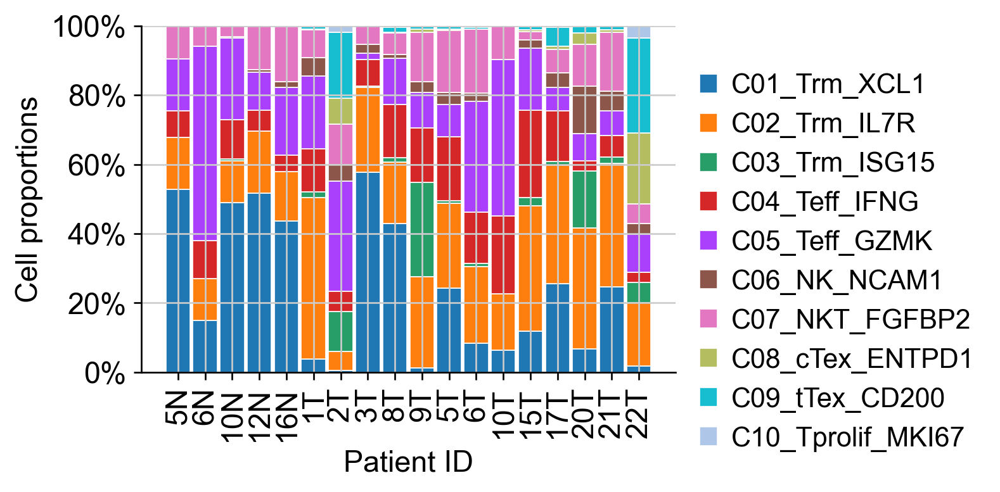

In [768]:
barlabels = ['5N', '6N', '10N', '12N','16N','1T', '2T', '3T', '8T', '9T', '5T','6T', '10T','15T','17T','20T', '21T', '22T']
cell_types = list(adata_CD8T.obs['anno-CD8T-har'].unique())
cell_types.sort()
# colors = pd.Series(sc.pl.palettes.default_20[:9], index=adata.obs['majorType-fix'].cat.categories)
# colors = ['#1f77b4', '#d62728','#ffbb78','#f7b6d2','#aec7e8']
age_df = pd.DataFrame(columns = list(cell_types))
for bar in barlabels:
    d1 = pd.DataFrame([len(adata_CD8T[(adata_CD8T.obs["anno-CD8T-har"] == ct) & (adata_CD8T.obs["batch"] == bar)]) for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
    age_df = pd.concat([age_df, d1])
fig0, ax0 = plt.subplots(figsize=(4.5, 3))
propPlot(age_df, ax=ax0, barlabels=barlabels)
fig0.savefig(f"figure-1.23/4c-proportions.svg",bbox_inches='tight')

In [ ]:
def propPloth(age_df, barlabels, ax, colors=sc.pl.palettes.default_20, xlabel='Patient ID', show_y=True, xrotate=90):
    all_df = age_df.sum(axis=1)
    age_normdf = pd.DataFrame([age_df.loc[i,:]/all_df[i] for i in barlabels], index=barlabels)
    age_cumdf = pd.DataFrame([np.cumsum(age_normdf.loc[i,:]) for i in barlabels], index=barlabels)
    norm_gdfs = age_normdf
    cum_gdfs = age_cumdf
    for i, col in enumerate(age_df.columns):
        height = norm_gdfs[col]
        starts = cum_gdfs[col] - height
        rects = ax.barh(barlabels, height, left=starts, height=0.9, color=colors[i], edgecolor='white', linewidth=0.5,
                        label=col, alpha=1)
    
        # ax.bar_label(rects,age_df.loc[:, col], label_type='center', color='lightgrey', fontsize=14)
    ax.legend( bbox_to_anchor=(1, 0.3), 
              handletextpad=0.5, frameon=False,
                          borderpad=0.4,
                          columnspacing=1,
                          handlelength=0.65,
              loc='lower left')
    if show_y:
        ax.xaxis.set_major_formatter(ticker.PercentFormatter(xmax=1,decimals=0))
        ax.set_xlabel('Cell proportions')
    else:
        ax.xaxis.set_visible(False)
        ax.spines.left.set_visible(False)
    ax.set_ylabel(xlabel)
    # ax.set_yticks(barlabels)
    # ax.set_xticklabels(labels=barlabels,rotation=xrotate)
    ax.spines.top.set_visible(False)
    ax.spines.right.set_visible(False)

In [ ]:
barlabels = [ '5N', '6N', '10N', '12N','16N','1T', '2T', '3T', '8T', '9T', '5T','6T', '10T','15T','17T','20T', '21T', '22T']
barlabels.reverse()
cell_types = list(adata_CD8T.obs['anno-CD8T'].unique())
cell_types.sort()
age_df = pd.DataFrame(columns = list(cell_types))

In [ ]:
for bar in barlabels:
    print('evaluating batch: ' + bar)
    d1 = pd.DataFrame([len(adata_CD8T[(adata_CD8T.obs["anno-CD8T"] == ct) & (adata_CD8T.obs["batch"] == bar)]) for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
    age_df = pd.concat([age_df, d1])

evaluating batch: 22T
evaluating batch: 21T
evaluating batch: 20T
evaluating batch: 17T
evaluating batch: 15T
evaluating batch: 10T
evaluating batch: 6T
evaluating batch: 5T
evaluating batch: 9T
evaluating batch: 8T
evaluating batch: 3T
evaluating batch: 2T
evaluating batch: 1T
evaluating batch: 16N
evaluating batch: 12N
evaluating batch: 10N
evaluating batch: 6N
evaluating batch: 5N


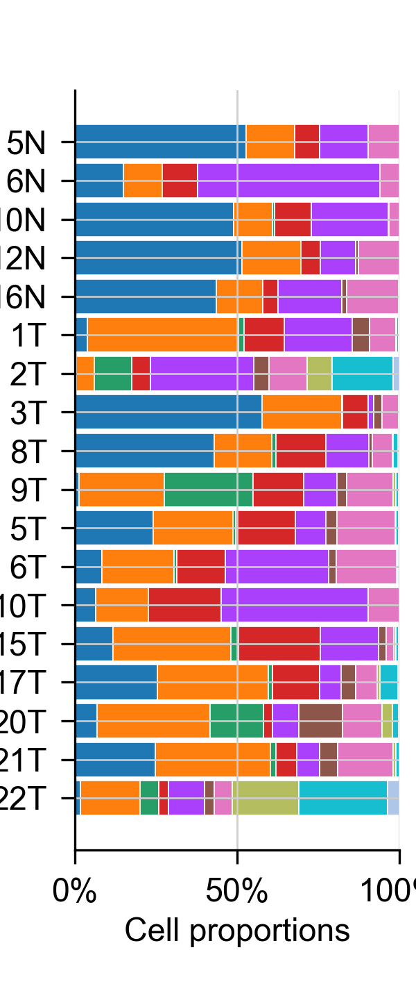

In [ ]:
fig0, ax0 = plt.subplots(figsize=(2.5, 6))
propPloth(age_df, ax=ax0, barlabels=barlabels, xlabel='')
fig0.savefig(f"figure-1.23/CD8T_proportionsh.svg",bbox_inches='tight')

evaluating batch: 22T
evaluating batch: 21T
evaluating batch: 20T
evaluating batch: 17T
evaluating batch: 15T
evaluating batch: 10T
evaluating batch: 6T
evaluating batch: 5T
evaluating batch: 9T
evaluating batch: 8T
evaluating batch: 3T
evaluating batch: 2T
evaluating batch: 1T
evaluating batch: 16N
evaluating batch: 12N
evaluating batch: 10N
evaluating batch: 6N
evaluating batch: 5N


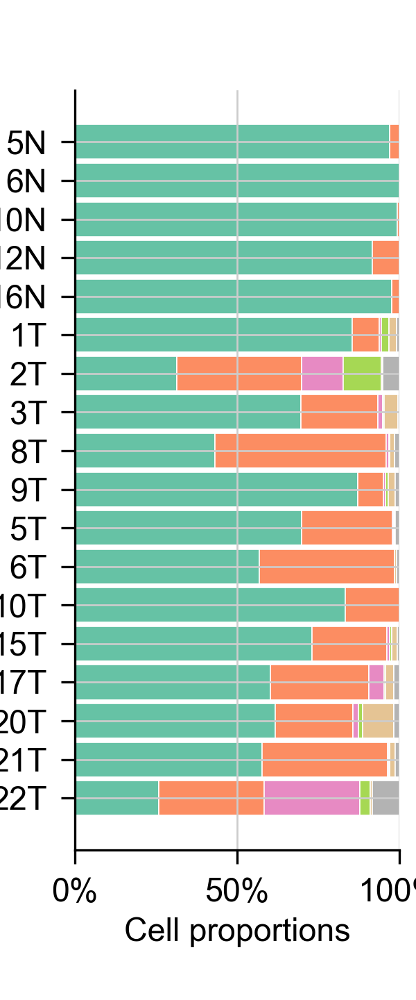

In [ ]:
barlabels = [ '5N', '6N', '10N', '12N','16N','1T', '2T', '3T', '8T', '9T', '5T','6T', '10T','15T','17T','20T', '21T', '22T']
barlabels.reverse()
cell_types = list(adata_CD4T.obs['anno-CD4T'].unique())
cell_types.sort()
age_df = pd.DataFrame(columns = list(cell_types))
for bar in barlabels:
    print('evaluating batch: ' + bar)
    d1 = pd.DataFrame([len(adata_CD4T[(adata_CD4T.obs["anno-CD4T"] == ct) & (adata_CD4T.obs["batch"] == bar)]) for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
    age_df = pd.concat([age_df, d1])
fig0, ax0 = plt.subplots(figsize=(2.5, 6))
colors=['#66c2a5', '#fc8d62', '#e78ac3', '#a6d854', '#e5c494', '#b3b3b3']
propPloth(age_df, ax=ax0, barlabels=barlabels, xlabel='', colors=colors)
fig0.savefig(f"figure-1.23/CD4T_proportionsh.svg",bbox_inches='tight')

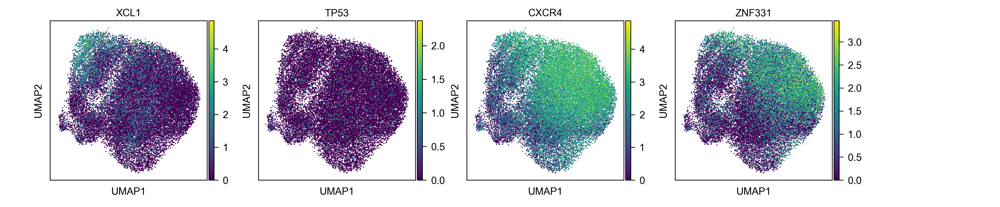

In [1096]:
sc.pl.umap(adata_CD8T, color=['XCL1', 'TP53', 'CXCR4', 'ZNF331'], size=10)

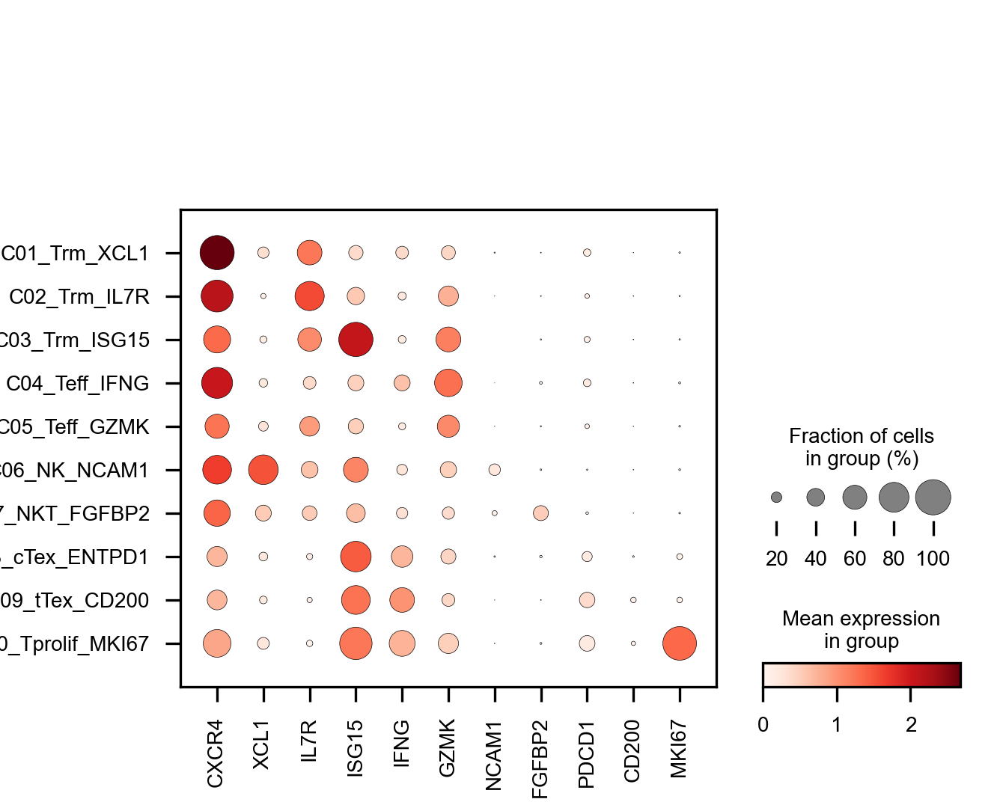

In [990]:
sc.pl.dotplot(adata_CD8T, groupby='anno-CD8T-har', var_names=['CXCR4','XCL1', 'IL7R', 'ISG15', 'IFNG', 'GZMK', 'NCAM1', 'FGFBP2', 'PDCD1', 'CD200', 'MKI67'])

In [751]:
for gene in ['CD3D', 'CD8A', 'CD69', 'FCGR3A', 'NCAM1', 'LAG3', 'PDCD1', 'TIGIT', 'CXCL13','ENTPD1','IFNG', 'GZMK', 'XCL1','CCR7', 'IL7R', 'ZNF683']:
  fig, ax = plt.subplots(1, 1, figsize=(4, 4))
  sc.pl.umap(adata_CD8T, color=gene,size=10, ax=ax, title='',show=False)
  ax.spines['right'].set_visible(False)
  ax.spines['top'].set_visible(False)
  ax.spines['left'].set_visible(False)
  ax.spines['bottom'].set_visible(False)
  ax.set_xlabel("")
  ax.set_ylabel("")
  # ax.legend(  handletextpad=0.5, frameon=False,
  #                     borderpad=0.6,
  #                     columnspacing=1.3,
  #                     handlelength=0.65, fontsize=12)
  fig.savefig(f"figure-1.23/S1b-{gene}.png", dpi=400, bbox_inches='tight')

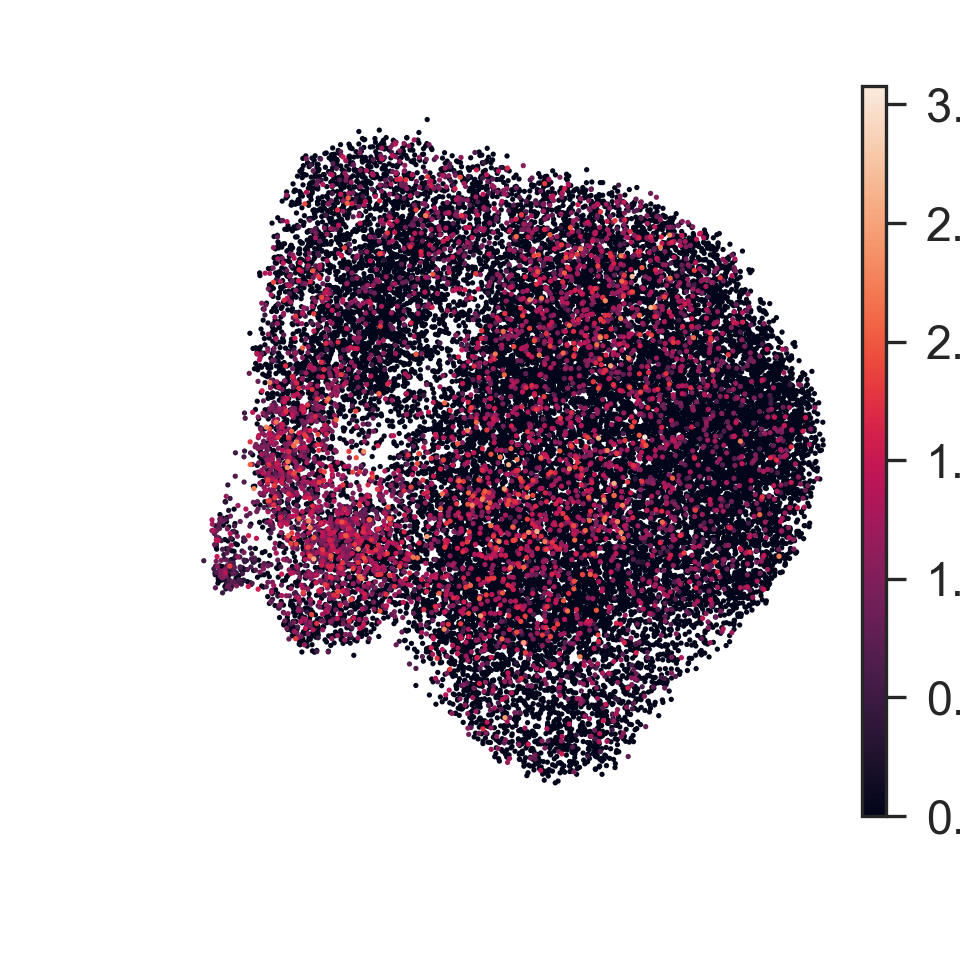

In [1300]:
for gene in ['ITGAE']:
  fig, ax = plt.subplots(1, 1, figsize=(4, 4))
  sc.pl.umap(adata_CD8T, color=gene,size=10, ax=ax, title='',show=False,palette='viridis')
  ax.spines['right'].set_visible(False)
  ax.spines['top'].set_visible(False)
  ax.spines['left'].set_visible(False)
  ax.spines['bottom'].set_visible(False)
  ax.set_xlabel("")
  ax.set_ylabel("")
  # ax.legend(  handletextpad=0.5, frameon=False,
  #                     borderpad=0.6,
  #                     columnspacing=1.3,
  #                     handlelength=0.65, fontsize=12)
  fig.savefig(f"figure-1.23/S1b-{gene}.png", dpi=400, bbox_inches='tight')

In [972]:
sc.tl.rank_genes_groups(adata_CD8T, groupby='anno-CD8T-har')
sc.tl.filter_rank_genes_groups(adata_CD8T)
sc.tl.dendrogram(adata_CD8T, groupby='anno-CD8T-har')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:05)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 1, max_out_group_fraction: 0.5
    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_anno-CD8T-har']`


categories: C01_Trm_XCL1, C02_Trm_IL7R, C03_Trm_ISG15, etc.
var_group_labels: C01_Trm_XCL1


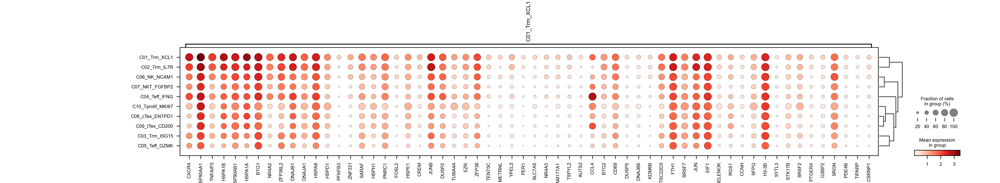

In [992]:
sc.pl.rank_genes_groups_dotplot(adata_CD8T, groups=['C01_Trm_XCL1'], n_genes=60)

In [1000]:
from gseapy import Msigdb
import gseapy as gp
msig = Msigdb()
# mouse hallmark gene sets
gmt = msig.get_gmt(category='mh.all', dbver="2023.2.Hs")
gmt

In [1006]:
def run_enrichr(adata):
  print("## Running Enrichr enrichment analysis...")
  result = adata.uns['rank_genes_groups']
  groups = result['names'].dtype.names
  degs = pd.DataFrame(
      {group + '_' + key: result[key][group]
      for group in groups for key in ['names','scores', 'pvals','pvals_adj','logfoldchanges']})
  # subset up or down regulated genes
  for ct in result['names'].dtype.names:
    print(f"## Enrichment analysis for {ct}...")
    degs_sig = degs[degs[f"{ct}_pvals_adj"] < 0.05]
    degs_up = degs_sig[degs_sig[f'{ct}_logfoldchanges'] > 0.1]
    degs_dw = degs_sig[degs_sig[f'{ct}_logfoldchanges'] < -0.1]
    enr_up = gp.enrichr(degs_up[f'{ct}_names'],
                        gene_sets='KEGG_2021_Human',
                        outdir=None)
    cc_up = gp.enrichr(degs_up[f'{ct}_names'],
                        gene_sets='GO_Cellular_Component_2023',
                        outdir=None)
    hm_up = gp.enrichr(degs_up[f'{ct}_names'],
                        gene_sets=['MSigDB_Hallmark_2020'],
                        outdir=None)
    mf_up = gp.enrichr(degs_up[f'{ct}_names'],
                        gene_sets='GO_Molecular_Function_2023',
                        outdir=None)
    bp_up = gp.enrichr(degs_up[f'{ct}_names'],
                        gene_sets=['GO_Biological_Process_2023'],
                        outdir=None)
    go_res = pd.concat([enr_up.res2d.head(15),hm_up.res2d.head(15), cc_up.res2d.head(15), bp_up.res2d.head(15), mf_up.res2d.head(15)])
    ax = gp.barplot(go_res, figsize=(6,20),
                    group ='Gene_set',
                    top_term=15,
                    color = ['#8b9cc4', '#f08961', '#62bb9f', '#e71f19', '#3d5eaa'],
                    title =f"The Most Enriched Terms Up in {ct}")
    ax.figure.savefig(f"figure-1.23/{ct}_bar.svg", bbox_inches='tight')
    print(f"## Saving enriched terms to figure-1.23/{ct}_enrichr.csv...")
    go_res.to_csv(f"figure-1.23/{ct}_enrichr.csv")
  print("## Enrichr enrichment analysis finished.")

In [ ]:
run_enrichr(adata_CD8T)

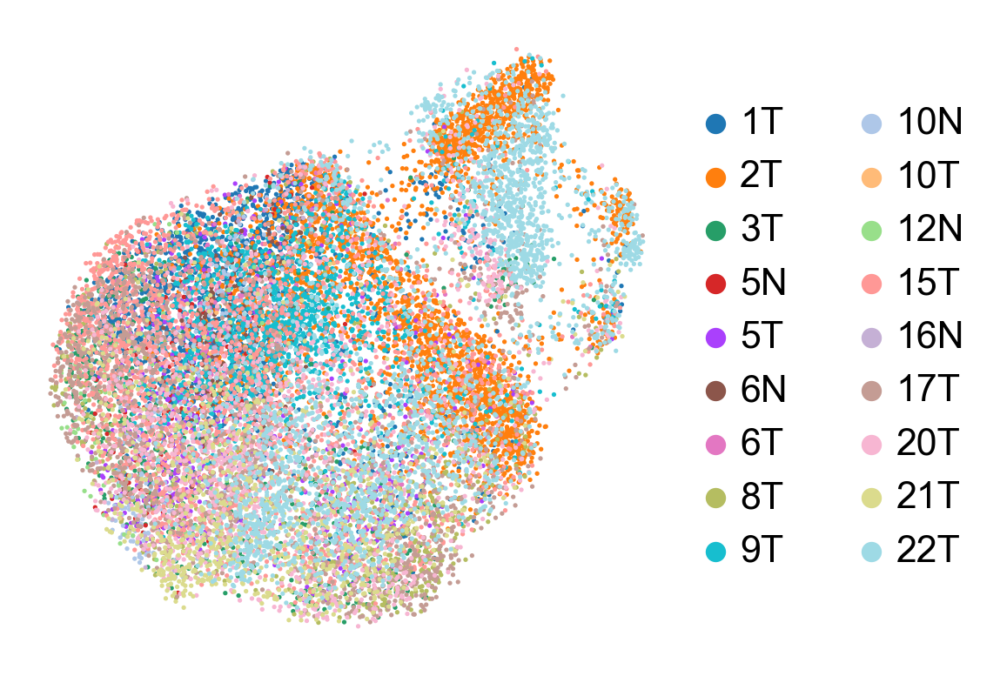

In [779]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.umap(adata_CD4T, color=['batch'], show=False, ax=ax, title='', size=10, palette=sc.pl.palettes.vega_20_scanpy)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
# ax.legend(  handletextpad=0.5, frameon=False,
#                     borderpad=0.6,
#                     columnspacing=1.3,
#                     handlelength=0.65, fontsize=12)
fig.savefig(f"figure-1.23/S4c-batch_CD4T.png", dpi=400, bbox_inches='tight')

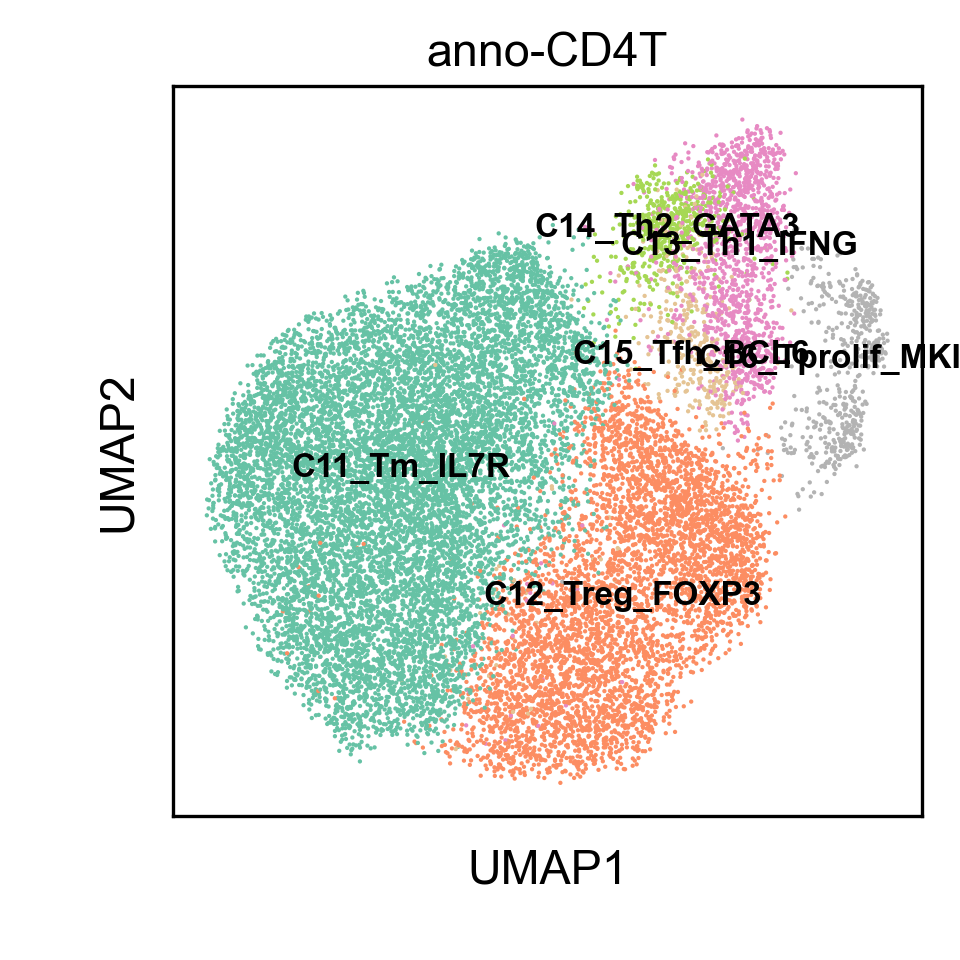

In [845]:
sc.pl.umap(adata_CD4T, color=['anno-CD4T'], legend_loc='on data')

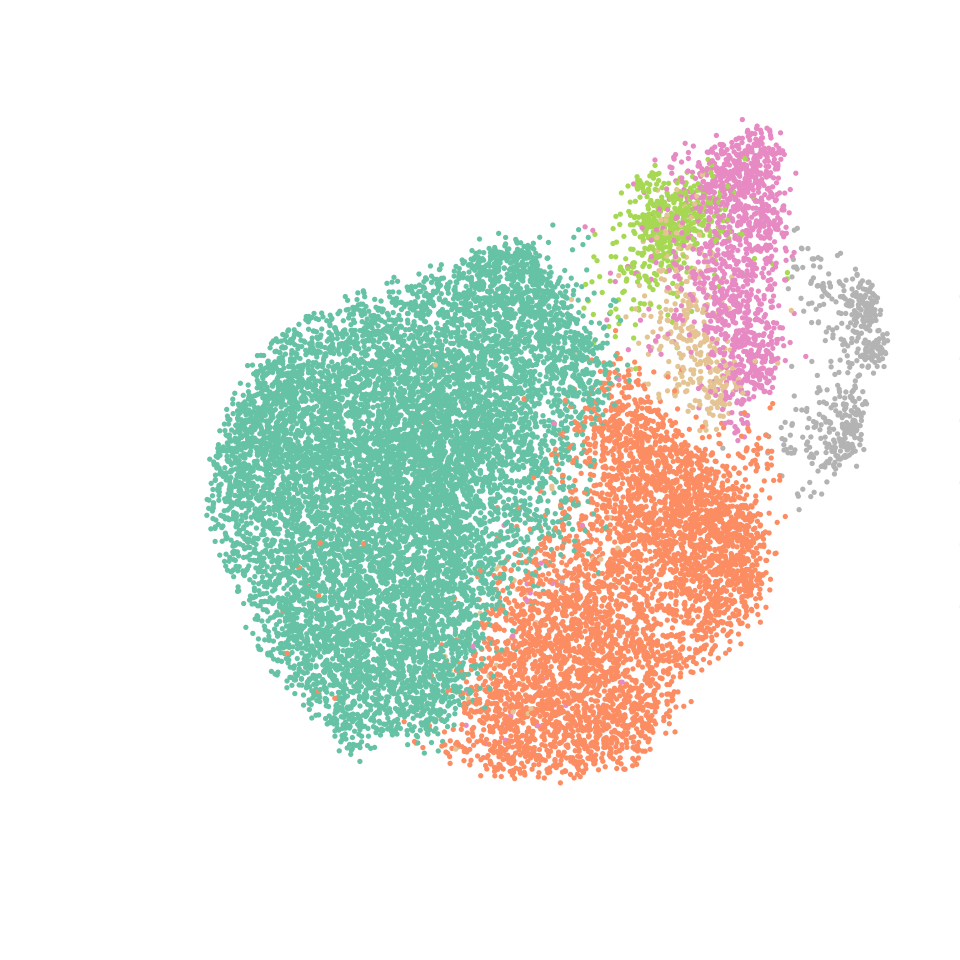

In [848]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.umap(adata_CD4T, color=['anno-CD4T'], show=False, ax=ax, title='', size=10, palette='Set2')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
# ax.legend(  handletextpad=0.5, frameon=False,
#                     borderpad=0.6,
#                     columnspacing=1.3,
#                     handlelength=0.65, fontsize=12)
fig.savefig(f"figure-1.23/4c-anno_CD4T.png", dpi=400, bbox_inches='tight')

In [ ]:
for gene in ['CD4', 'FOXP3', 'TNFRSF18','LAG3', 'PDCD1', 'TIGIT', 'CXCL13','ENTPD1','IFNG', 'GZMK', 'XCL1','CCR7', 'IL7R', 'ISG15']:
  fig, ax = plt.subplots(1, 1, figsize=(4, 4))
  sc.pl.umap(adata_CD4T, color=gene,size=10, ax=ax, title='',show=False)
  ax.spines['right'].set_visible(False)
  ax.spines['top'].set_visible(False)
  ax.spines['left'].set_visible(False)
  ax.spines['bottom'].set_visible(False)
  ax.set_xlabel("")
  ax.set_ylabel("")
  # ax.legend(  handletextpad=0.5, frameon=False,
  #                     borderpad=0.6,
  #                     columnspacing=1.3,
  #                     handlelength=0.65, fontsize=12)
  fig.savefig(f"figure-1.23/S4e-{gene}.png", dpi=400, bbox_inches='tight')

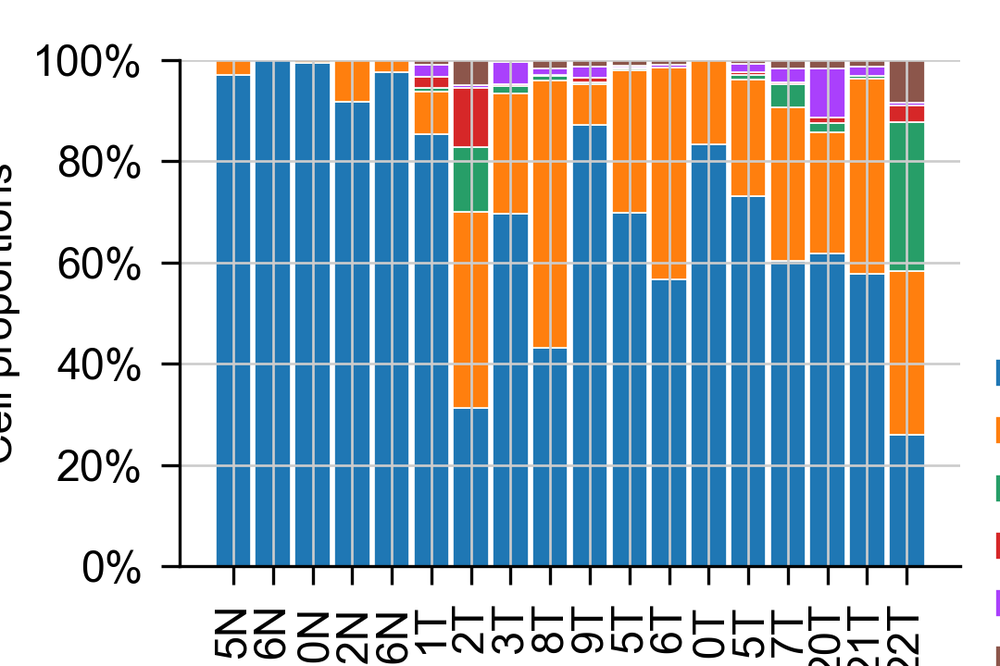

In [1007]:
barlabels = ['5N', '6N', '10N', '12N','16N','1T', '2T', '3T', '8T', '9T', '5T','6T', '10T','15T','17T','20T', '21T', '22T']
cell_types = list(adata_CD4T.obs['anno-CD4T'].unique())
cell_types.sort()
# colors = pd.Series(sc.pl.palettes.default_20[:9], index=adata.obs['majorType-fix'].cat.categories)
# colors = ['#1f77b4', '#d62728','#ffbb78','#f7b6d2','#aec7e8']
age_df = pd.DataFrame(columns = list(cell_types))
for bar in barlabels:
    d1 = pd.DataFrame([len(adata_CD4T[(adata_CD4T.obs["anno-CD4T"] == ct) & (adata_CD4T.obs["batch"] == bar)]) for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
    age_df = pd.concat([age_df, d1])
fig0, ax0 = plt.subplots(figsize=(4.5, 3))
propPlot(age_df, ax=ax0, barlabels=barlabels, colors=sc.pl.palettes.default_20)
fig0.savefig(f"figure-1.23/4d-proportions2.svg",bbox_inches='tight')

In [849]:
from cellphonedb.src.core.methods import cpdb_statistical_analysis_method
import ktplotspy as kpy

In [ ]:
adata_concat = sc.read_h5ad("adata-epi-concat-12.17.h5ad")

In [850]:
adata_CD8T.obs['cptype'] = adata_CD8T.obs['anno-CD8T-har']
adata_concat.obs['cptype'] = adata_concat.obs['annotation']
adata_epi_CD8T = adata_CD8T.concatenate(adata_concat[adata_concat.obs['age'] == 'Young'])
adata_epi_CD8T

AnnData object with n_obs × n_vars = 90301 × 17133
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix', 'leiden-T', 'leiden-Tmix', 'leiden-CD8T', 'anno-CD8T', 'sample', 'tech', 'ano-CD8T-har', 'anno-CD8T-har', 'cptype', 'age', 'IHC', 'study', 'annotation', 'cnv_score', 'cnv_status', 'leiden-1', 'ori.annotation', 'dpt_pseudotime', 'CDH1_mRNA', 'CDH1_attr'
    var: 'n_cells_by_counts-0', 'mean_counts-0', 'log1p_mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'log1p_total_counts-0', 'n_cells-0', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'highly_variable-1', 'means-1', 'dispersions-1', 'dispersions_norm-1', 'n_cells-Non-young-1', 'hig

In [855]:
adata_CD8T.obs['cptype'] = adata_CD8T.obs['anno-CD8T-har']
adata_concat.obs['cptype'] = adata_concat.obs['annotation']
adata_epi_CD8T_old = adata_CD8T.concatenate(adata_concat[adata_concat.obs['age'] == 'Non-young'])
adata_epi_CD8T_old.obs_names_make_unique()
adata_epi_CD8T_old.write_h5ad("adata-epi-CD8T-old-2.11.h5ad")

In [ ]:
meta = pd.DataFrame(adata_epi_CD8T_old.obs['cptype'].copy())
meta = meta.reset_index()
meta.columns=['Cell', 'cell_type']
meta.to_csv("meta.txt", sep='\t', index=False)
cpdb_res_em = cpdb_statistical_analysis_method.call(
  cpdb_file_path="cellphonedb.zip",
  meta_file_path="meta.txt",
  counts_file_path="adata-epi-CD8T-old-2.11.h5ad",
  counts_data='hgnc_symbol',
  output_path="cpdb",
  threads=16,
)


Reading user files...
The following user files were loaded successfully:
adata-epi-CD8T-old-2.11.h5ad
meta.txt
[ ][CORE][11/02/25-08:47:51][INFO] [Cluster Statistical Analysis] Threshold:0.1 Iterations:1000 Debug-seed:-1 Threads:16 Precision:3
[ ][CORE][11/02/25-08:47:54][INFO] Running Real Analysis
[ ][CORE][11/02/25-08:47:54][INFO] Running Statistical Analysis


100%|██████████| 1000/1000 [08:22<00:00,  1.99it/s]

[ ][CORE][11/02/25-08:56:16][INFO] Building Pvalues result


[ ][CORE][11/02/25-08:56:17][INFO] Building results
Saved deconvoluted to cpdb/statistical_analysis_deconvoluted_02_11_2025_085618.txt
Saved deconvoluted_percents to cpdb/statistical_analysis_deconvoluted_percents_02_11_2025_085618.txt
Saved means to cpdb/statistical_analysis_means_02_11_2025_085618.txt
Saved pvalues to cpdb/statistical_analysis_pvalues_02_11_2025_085618.txt
Saved significant_means to cpdb/statistical_analysis_significant_means_02_11_2025_085618.txt


AnnData object with n_obs × n_vars = 41259 × 17133
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix', 'leiden-T', 'leiden-Tmix', 'leiden-CD8T', 'anno-CD8T', 'sample', 'tech', 'ano-CD8T-har', 'anno-CD8T-har', 'cptype', 'age', 'IHC', 'study', 'annotation', 'cnv_score', 'cnv_status', 'leiden-1', 'ori.annotation', 'dpt_pseudotime', 'CDH1_mRNA', 'CDH1_attr'
    var: 'n_cells_by_counts-0', 'mean_counts-0', 'log1p_mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'log1p_total_counts-0', 'n_cells-0', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'highly_variable-1', 'means-1', 'dispersions-1', 'dispersions_norm-1', 'n_cells-Non-young-1', 'hig

In [857]:
adata_epi_CD8T_old.uns['CellphoneDB'] = cpdb_res_em
adata_epi_CD8T_old

AnnData object with n_obs × n_vars = 41259 × 17133
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix', 'leiden-T', 'leiden-Tmix', 'leiden-CD8T', 'anno-CD8T', 'sample', 'tech', 'ano-CD8T-har', 'anno-CD8T-har', 'cptype', 'age', 'IHC', 'study', 'annotation', 'cnv_score', 'cnv_status', 'leiden-1', 'ori.annotation', 'dpt_pseudotime', 'CDH1_mRNA', 'CDH1_attr'
    var: 'n_cells_by_counts-0', 'mean_counts-0', 'log1p_mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'log1p_total_counts-0', 'n_cells-0', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'highly_variable-1', 'means-1', 'dispersions-1', 'dispersions_norm-1', 'n_cells-Non-young-1', 'hig

In [859]:
ct = list(adata_CD8T.obs['anno-CD8T-har'].unique())
ct.sort()
ct_str = '|'.join(ct)
ct_str                 

'C01_Trm_XCL1|C02_Trm_IL7R|C03_Trm_ISG15|C04_Teff_IFNG|C05_Teff_GZMK|C06_NK_NCAM1|C07_NKT_FGFBP2|C08_cTex_ENTPD1|C09_tTex_CD200|C10_Tprolif_MKI67'

In [982]:
ax = kpy.plot_cpdb(
  adata=adata_epi_CD8T,
  cell_type1="TNBC|HR+HER2-|HR+HER2+|HR-HER2+",
  cell_type2='C01_Trm_XCL1',
  means=adata_epi_CD8T.uns['CellphoneDB']['means'],
  pvals=adata_epi_CD8T_old.uns['CellphoneDB']['pvalues'],
  celltype_key='cptype',
  max_size=4,
  max_highlight_size=1,
  highlight_size=0.75,
  degs_analysis=False,
  standard_scale=True,
  figsize=(14,14),
)
ax.save(f'figure-1.23/cpdb_eXCL1_young.png', dpi=300)

In [869]:
adata_bcm  = sc.read_h5ad(f'{datapath}/adata-GSE176078.h5ad')
adata_bcm

AnnData object with n_obs × n_vars = 50000 × 21864
    obs: 'type', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mito', 'subtype', 'celltype_subset', 'celltype_minor', 'celltype_major', 'batch', 'mt_frac', 'n_genes', 'n_counts', 'doublet_score', 'predicted_doublet', 'leiden-1', 'UCell_B cells', 'UCell_B cells memory', 'UCell_B cells naive', 'UCell_Basophils', 'UCell_Dendritic cells', 'UCell_Eosinophils', 'UCell_Erythroblasts', 'UCell_Erythroid-like and erythroid precursor cells', 'UCell_Gamma delta T cells', 'UCell_Macrophages', 'UCell_Mast cells', 'UCell_Megakaryocytes', 'UCell_Monocytes', 'UCell_Myeloid-derived suppressor cells', 'UCell_NK cells', 'UCell_Natural killer T cells', 'UCell_Neutrophils', 'UCell_Nuocytes', 'UCell_Plasma cells', 'UCell_Plasmacytoid dendritic cells', 'UCell_Platelets', 'UCell_Red pulp macrophages', 'UCell_Reticulocytes', 'UCell_T cells', 'UCell_T cytotoxic cells', 'UCell_T follicular helper cells', 'UCell_T helper cells', 'UCell_T memory cells', 'UCe

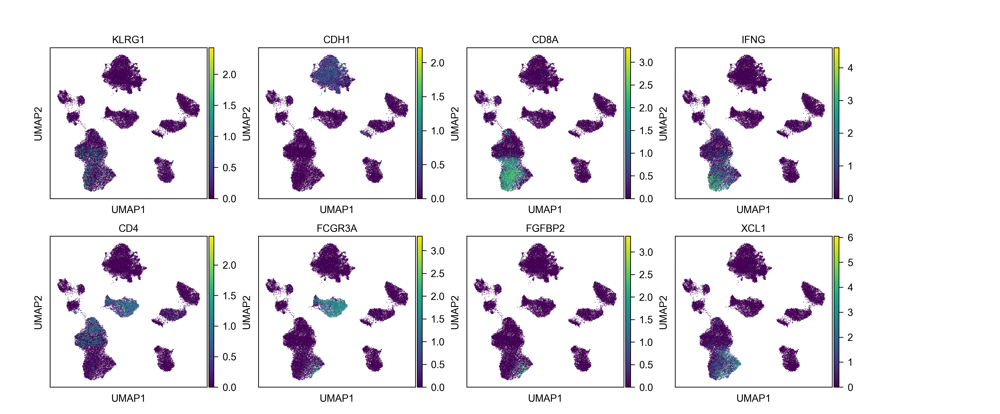

In [872]:
sc.pl.umap(adata_bcm, color=['KLRG1', 'CDH1', 'CD8A', 'IFNG', 'CD4', 'FCGR3A', 'FGFBP2', 'XCL1'])

In [886]:
adata_bcm.obs['annotation']

CID44991_CCGTACTGTCTAGCGC-CID44991    Cancer Epithelial
CID4535_TCTCTAAGTAGGCATG-CID4535      Cancer Epithelial
CID4067_GTTCTCGGTCTCCATC-CID4067             Macrophage
CID3963_CTGCCTACAAGCCTAT-CID3963            CD8+ T cell
CID3963_TCTCATAAGGACGAAA-CID3963            CD8+ T cell
                                            ...        
CID4523_CTGGTCTGTTGGAGGT-CID4523                NK cell
CID4471_ACTTACTCACATGGGA-CID4471           Cancer Basal
CID4290A_GCACTCTTCGATCCCT-CID4290A    Normal Epithelial
CID4040_AGGTCATGTGATAGAT-CID4040            CD4+ T cell
CID44971_TTAGGCATCATAACCG-CID44971                 Treg
Name: annotation, Length: 50000, dtype: category
Categories (16, object): ['B cell', 'CD4+ T cell', 'CD8+ T cell', 'Cancer Basal', ..., 'Pericyte', 'Plasma', 'Plasmablast', 'Treg']

Ignoring processing doublet cells...
If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes


    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


2025-02-11 09:50:29,309 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-02-11 09:50:33,208 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-02-11 09:50:33,248 - harmonypy - INFO - Iteration 1 of 50
2025-02-11 09:50:35,375 - harmonypy - INFO - Iteration 2 of 50
2025-02-11 09:50:37,433 - harmonypy - INFO - Iteration 3 of 50
2025-02-11 09:50:39,389 - harmonypy - INFO - Iteration 4 of 50
2025-02-11 09:50:41,029 - harmonypy - INFO - Iteration 5 of 50
2025-02-11 09:50:42,155 - harmonypy - INFO - Iteration 6 of 50
2025-02-11 09:50:43,214 - harmonypy - INFO - Iteration 7 of 50
2025-02-11 09:50:44,315 - harmonypy - INFO - Iteration 8 of 50
2025-02-11 09:50:45,249 - harmonypy - INFO - Iteration 9 of 50
2025-02-11 09:50:46,375 - harmonypy - INFO - Iteration 10 of 50
2025-02-11 09:50:47,425 - harmonypy - INFO - Iteration 11 of 50
2025-02-11 09:50:48,411 - harmonypy - INFO - Iteration 12 of 50
2025-02-11 09:50:49,337 - harmonypy - INFO - Iteration 13 of

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:17)
running Leiden clustering
    finished: found 15 clusters and added
    'leiden-CD8T', the cluster labels (adata.obs, categorical) (0:00:08)


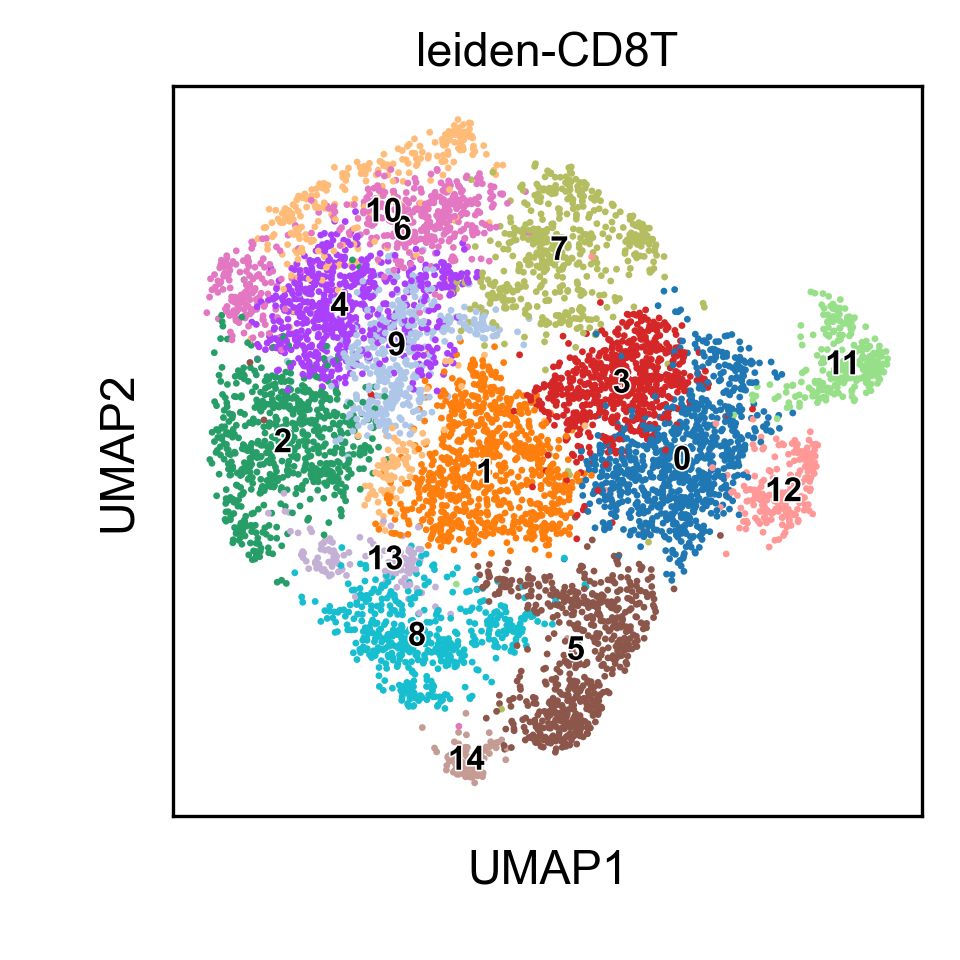

In [887]:
adata_CD8T_old =adata_bcm[adata_bcm.obs['annotation'].isin(['CD8+ T cell', 'NK cell'])]
adata_CD8T_old = clu(adata_CD8T_old, 'leiden-CD8T', do_har=True, max_iter=50)

Ignoring processing doublet cells...
If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:10)


2025-02-28 08:05:41,454 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-02-28 08:06:34,873 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-02-28 08:06:35,083 - harmonypy - INFO - Iteration 1 of 50
2025-02-28 08:07:00,285 - harmonypy - INFO - Iteration 2 of 50
2025-02-28 08:07:21,272 - harmonypy - INFO - Converged after 2 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:13)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:20)
running Leiden clustering
    finished: found 9 clusters and added
    'leiden-CD4T', the cluster labels (adata.obs, categorical) (0:00:23)


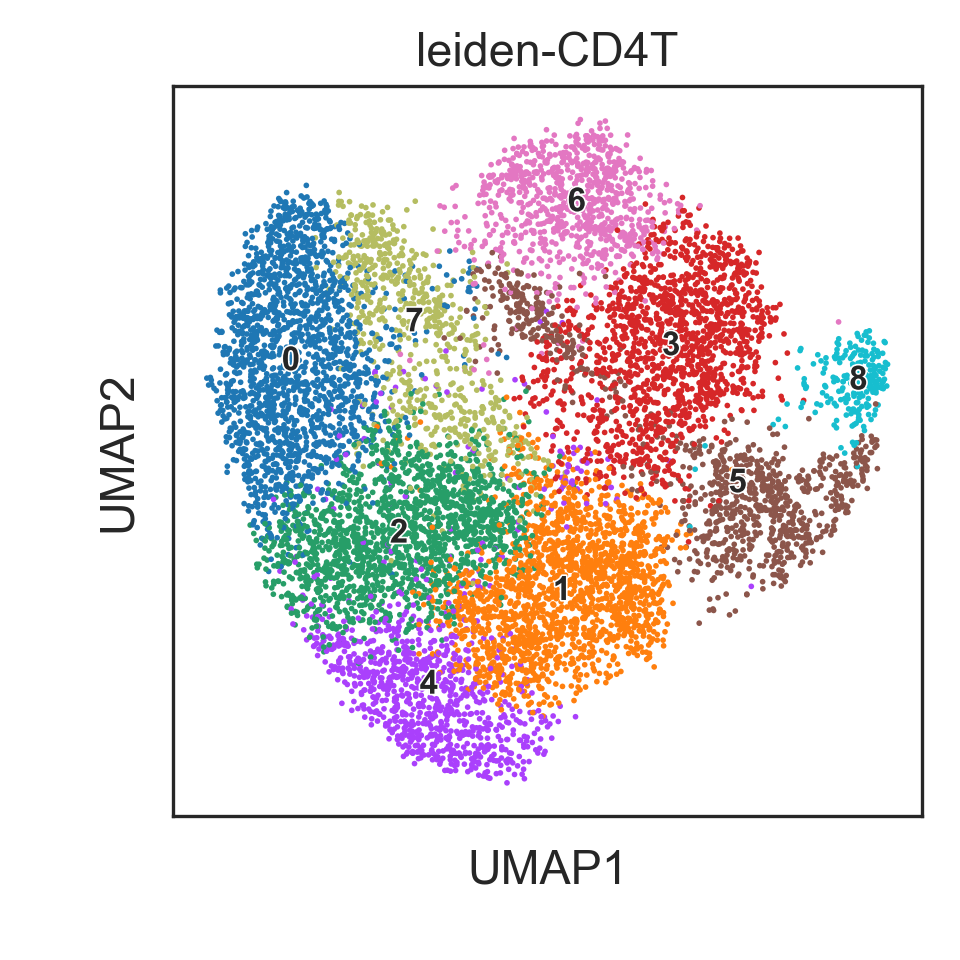

In [ ]:
adata_CD4T_old =adata_bcm[adata_bcm.obs['annotation'].isin(['CD4+ T cell', 'Treg'])]
adata_CD4T_old = clu(adata_CD4T_old, 'leiden-CD4T', do_har=True, max_iter=50)

In [ ]:
sc.tl.leiden(adata_CD4T_old, resolution=2, key_added='leiden-2')
sc.pl.umap(adata_CD4T_old, color=['leiden-2', 'batch'], legend_loc='on data')

running Leiden clustering
    finished: found 19 clusters and added
    'leiden-2', the cluster labels (adata.obs, categorical) (0:00:26)


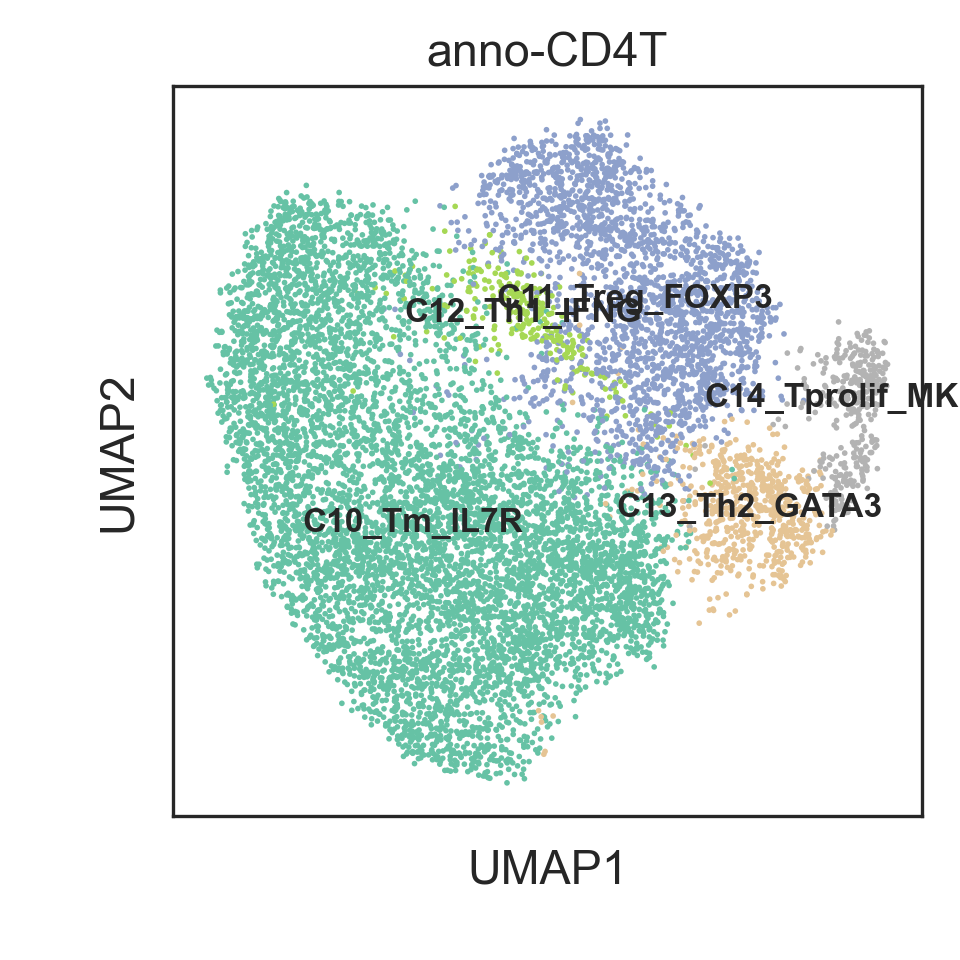

In [ ]:
annot = {
  'C10_Tm_IL7R':['1','2','4','5','6','7', '8', '10', '11', '15', '16', '17', '18'],  # IL7R
  'C11_Treg_FOXP3': ['0', '12', '3'],  # FOXP3
  'C12_Th1_IFNG': ['14'], # IFNG
  'C13_Th2_GATA3':['9'], # GATA3
  'C14_Tprolif_MKI67': ['13'], # MKI67
}
adata_CD4T_old = anno(adata=adata_CD4T_old, obsKey='anno-CD4T', obsVal='leiden-2', annoDict=annot)
sc.pl.umap(adata_CD4T_old, color=['anno-CD4T'], legend_loc='on data', palette='Set2')

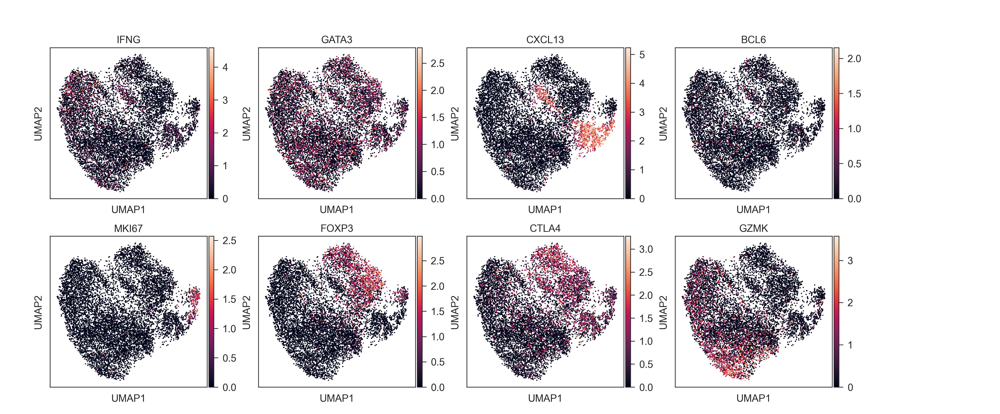

In [ ]:
sc.pl.umap(adata_CD4T_old, color=['IFNG', 'GATA3', 'CXCL13', 'BCL6', 'MKI67', 'FOXP3', 'CTLA4', 'GZMK'], legend_loc='on data')

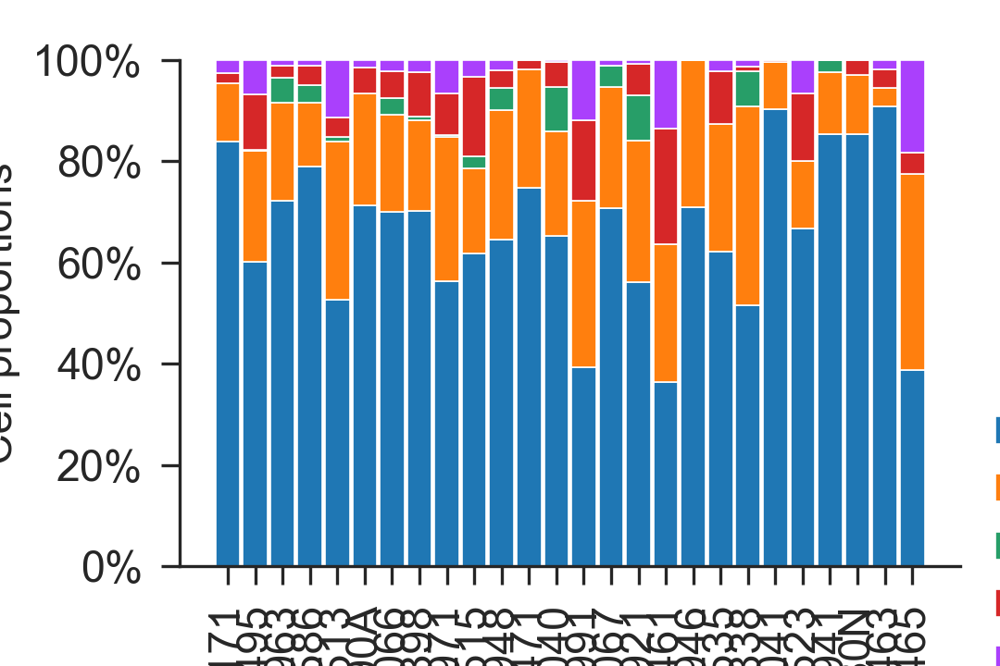

In [ ]:
barlabels = list(adata_CD4T_old.obs['batch'].unique())
cell_types = list(adata_CD4T_old.obs['anno-CD4T'].unique())
cell_types.sort()
# colors = pd.Series(sc.pl.palettes.default_20[:9], index=adata.obs['majorType-fix'].cat.categories)
# colors = ['#1f77b4', '#d62728','#ffbb78','#f7b6d2','#aec7e8']
age_df = pd.DataFrame(columns = list(cell_types))
for bar in barlabels:
    d1 = pd.DataFrame([len(adata_CD4T_old[(adata_CD4T_old.obs["anno-CD4T"] == ct) & (adata_CD4T_old.obs["batch"] == bar)]) for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
    age_df = pd.concat([age_df, d1])
fig0, ax0 = plt.subplots(figsize=(4.5, 3))
propPlot(age_df, ax=ax0, barlabels=barlabels, colors=sc.pl.palettes.color)
fig0.savefig(f"figure-1.23/4d-proportions4.svg",bbox_inches='tight')

In [ ]:
sc.tl.rank_genes_groups(adata_CD4T_old, groupby='anno-CD4T')
sc.tl.filter_rank_genes_groups(adata_CD4T_old)
sc.tl.dendrogram(adata_CD4T_old, groupby='anno-CD4T')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 1, max_out_group_fraction: 0.5
    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_anno-CD4T']`


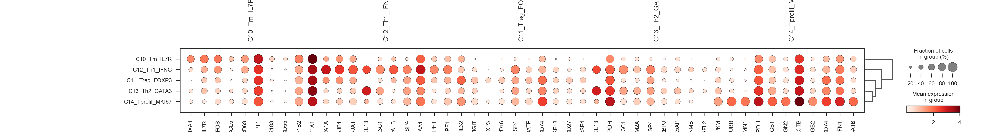

In [ ]:
sc.pl.rank_genes_groups_dotplot(adata_CD4T_old)

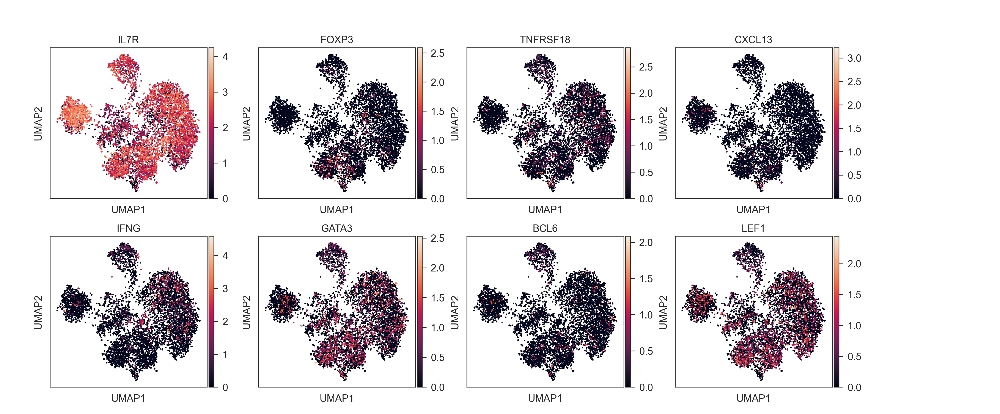

In [ ]:
sc.pl.umap(adata_CD4T_old, color=['IL7R', 'FOXP3', 'TNFRSF18', 'CXCL13', 'IFNG', 'GATA3', 'BCL6', 'LEF1'])

In [904]:
sc.tl.leiden(adata_CD8T_old, key_added='leiden-CD8T', resolution=1.3)

running Leiden clustering
    finished: found 19 clusters and added
    'leiden-CD8T', the cluster labels (adata.obs, categorical) (0:00:07)


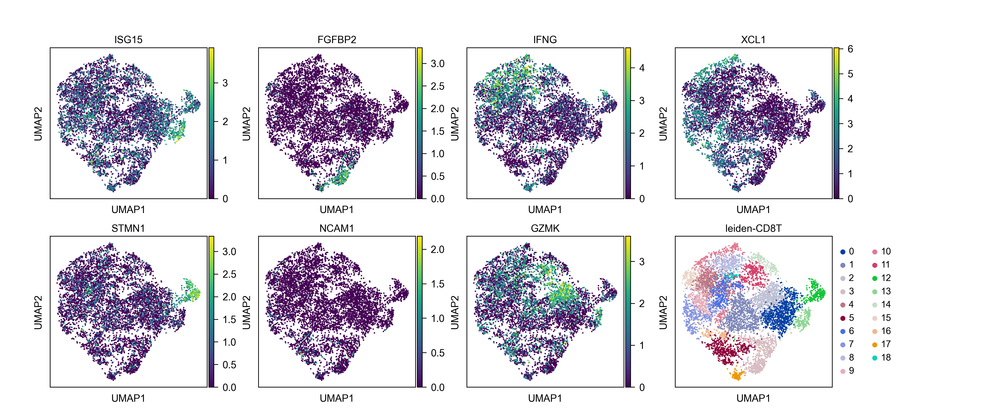

In [906]:
sc.pl.umap(adata_CD8T_old, color=['ISG15', 'FGFBP2', 'IFNG', 'XCL1', 'STMN1', 'NCAM1', 'GZMK','leiden-CD8T'])

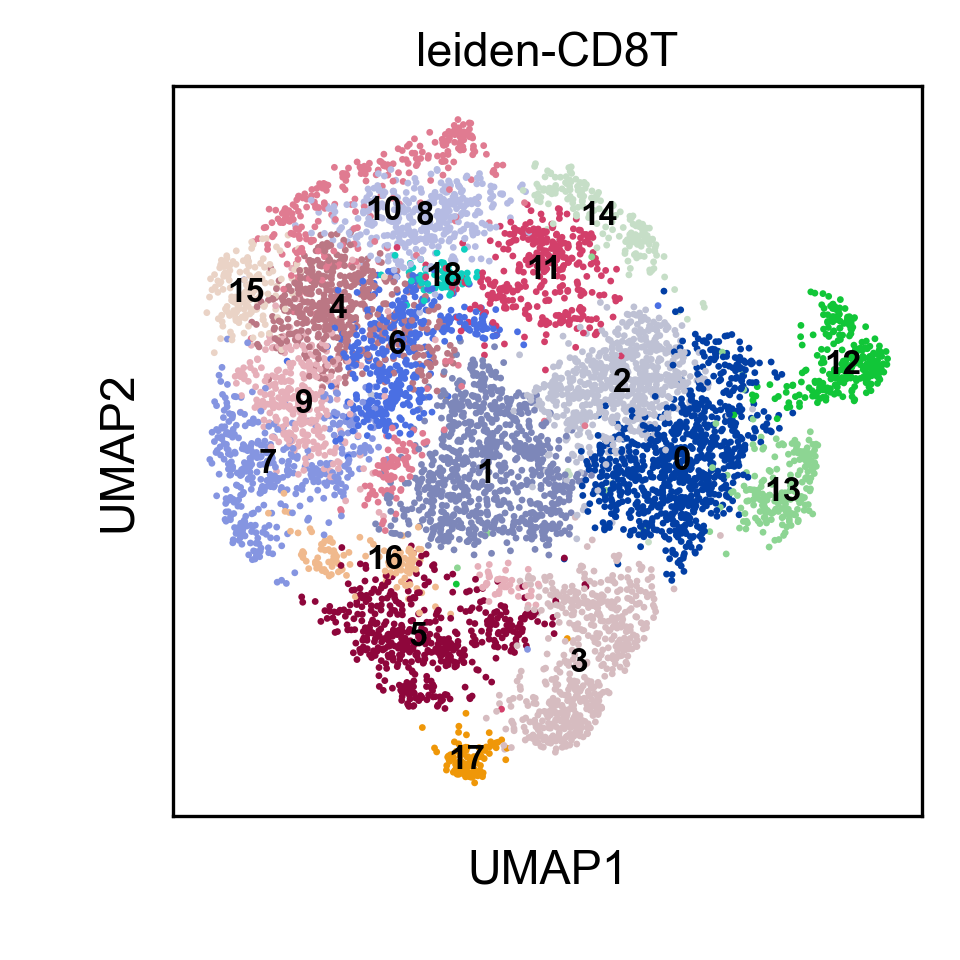

In [905]:
sc.pl.umap(adata_CD8T_old, color=['leiden-CD8T'], legend_loc='on data')

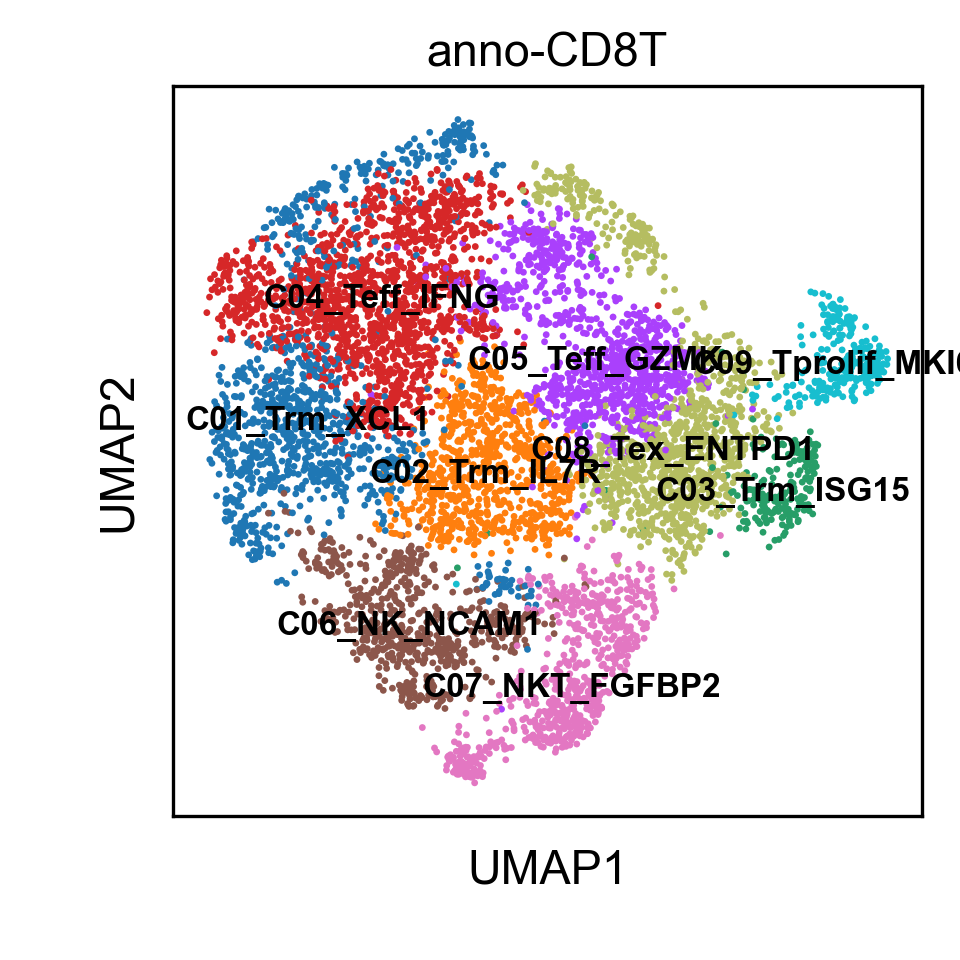

In [909]:
annot = {
  'C01_Trm_XCL1':['7', '9', '10'],  # XCL1
  'C02_Trm_IL7R': ['1'],  # IL7R
  'C03_Trm_ISG15': ['13'], # ISG15
  'C04_Teff_IFNG':['4', '6', '8', '15', '18'], # IFNG
  'C05_Teff_GZMK': ['2', '11'], # GZMK
  'C06_NK_NCAM1': ['5', '16'],  # NCAM1
  'C07_NKT_FGFBP2': ['3', '17'], # FCGR3A, FGFBP2
  'C08_Tex_ENTPD1': ['0', '14'],  #CXCL13 PDCD1 TIGIT LAG3
  'C09_Tprolif_MKI67': ['12'],  # MKI67
}
adata_CD8T_old = anno(adata=adata_CD8T_old, obsKey='anno-CD8T', obsVal='leiden-CD8T', annoDict=annot)
sc.pl.umap(adata_CD8T_old, color=['anno-CD8T'], legend_loc='on data')

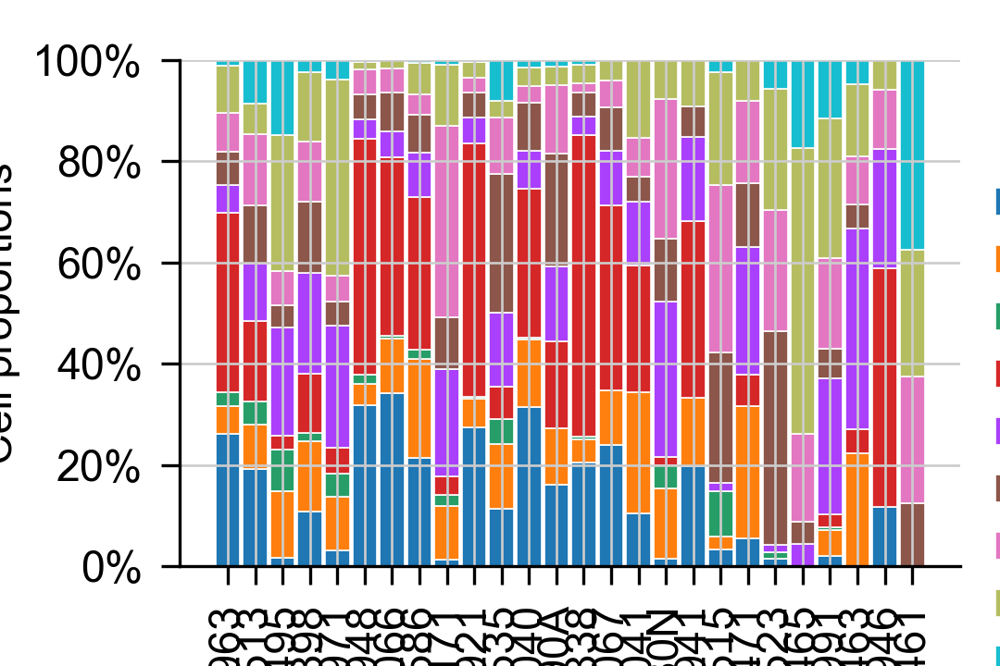

In [1053]:
barlabels = list(adata_CD8T_old.obs['batch'].unique())
cell_types = list(adata_CD8T_old.obs['anno-CD8T'].unique())
cell_types.sort()
# colors = pd.Series(sc.pl.palettes.default_20[:9], index=adata.obs['majorType-fix'].cat.categories)
# colors = ['#1f77b4', '#d62728','#ffbb78','#f7b6d2','#aec7e8']
age_df = pd.DataFrame(columns = list(cell_types))
for bar in barlabels:
    d1 = pd.DataFrame([len(adata_CD8T_old[(adata_CD8T_old.obs["anno-CD8T"] == ct) & (adata_CD8T_old.obs["batch"] == bar)]) for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
    age_df = pd.concat([age_df, d1])
fig0, ax0 = plt.subplots(figsize=(4.5, 3))
propPlot(age_df, ax=ax0, barlabels=barlabels, colors=sc.pl.palettes.default_20)
fig0.savefig(f"figure-1.23/4d-proportions3.svg",bbox_inches='tight')

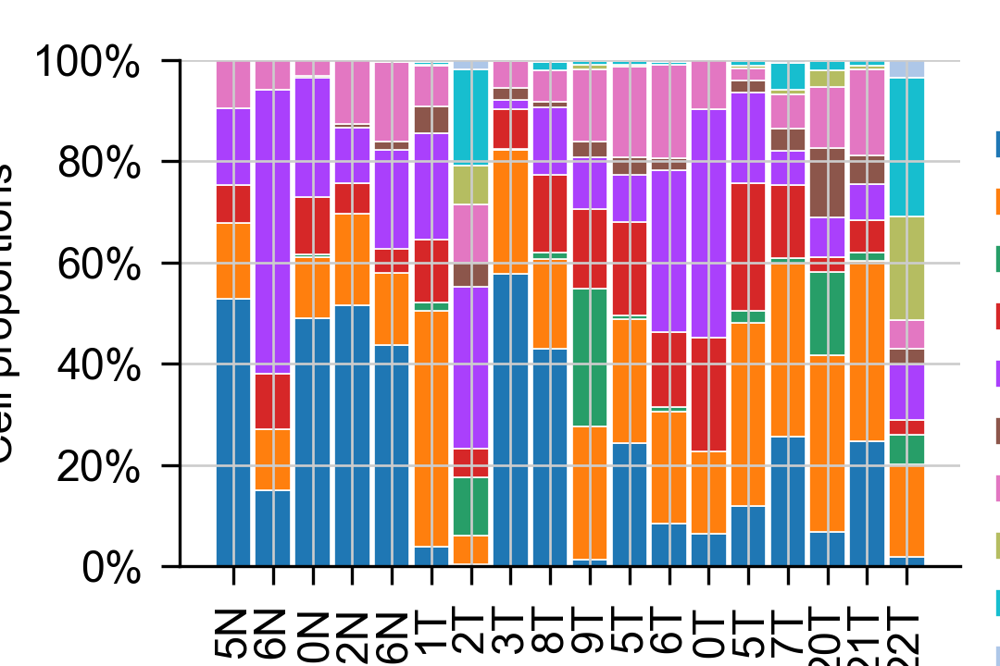

In [1098]:
barlabels = ['5N', '6N', '10N', '12N','16N','1T', '2T', '3T', '8T', '9T', '5T','6T', '10T','15T','17T','20T', '21T', '22T']
cell_types = list(adata_CD8T.obs['anno-CD8T-har'].unique())
cell_types.sort()
# colors = pd.Series(sc.pl.palettes.default_20[:9], index=adata.obs['majorType-fix'].cat.categories)
# colors = ['#1f77b4', '#d62728','#ffbb78','#f7b6d2','#aec7e8']
age_df = pd.DataFrame(columns = list(cell_types))
for bar in barlabels:
    d1 = pd.DataFrame([len(adata_CD8T[(adata_CD8T.obs["anno-CD8T-har"] == ct) & (adata_CD8T.obs["batch"] == bar)]) for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
    age_df = pd.concat([age_df, d1])
fig0, ax0 = plt.subplots(figsize=(4.5, 3))
propPlot(age_df, ax=ax0, barlabels=barlabels)
fig0.savefig(f"figure-1.23/4c-proportions.svg",bbox_inches='tight')

In [1072]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler

In [1107]:
young_df = age_df
young_df['C08_Tex_PDCD1'] = young_df['C08_cTex_ENTPD1'] + young_df['C09_tTex_CD200'] # merge Tex subclusters
del young_df['C08_cTex_ENTPD1']
del young_df['C09_tTex_CD200']
all_df = young_df.sum(axis=1)
young_normdf = pd.DataFrame([young_df.loc[i,:]/all_df[i] for i in barlabels], index=barlabels)
scaler = StandardScaler()
young_scaledf = scaler.fit_transform(young_normdf.T)
young_scaledf = pd.DataFrame(young_scaledf.T, columns=young_normdf.columns)
young_scaledf['age'] = 'Young'

In [1084]:
all_df = age_df.sum(axis=1)
age_normdf = pd.DataFrame([age_df.loc[i,:]/all_df[i] for i in barlabels], index=barlabels)

In [1090]:
scaler = StandardScaler()
scaled_df = scaler.fit_transform(age_normdf.T)
scaled_df = pd.DataFrame(scaled_df.T, columns=age_normdf.columns)
scaled_df['age'] = 'Non-young'

In [1110]:
scaled_df['Trm_XCL1']  = scaled_df['C01_Trm_XCL1']
scaled_df['Tex_PDCD1']  = scaled_df['C08_Tex_ENTPD1']
young_scaledf['Trm_XCL1']  = young_scaledf['C01_Trm_XCL1']
young_scaledf['Tex_PDCD1']  = young_scaledf['C08_Tex_PDCD1']
total_df = pd.concat([young_scaledf[['Tex_PDCD1','Trm_XCL1','age']],scaled_df[['Tex_PDCD1','Trm_XCL1','age']]],axis=0)
total_df

,Tex_PDCD1,Trm_XCL1,age
0,-0.698792,2.619593,Young
1,-0.657839,0.231832,Young
2,-0.722250,2.460689,Young
3,-0.711989,2.594489,Young
4,-0.795006,2.397966,Young
5,-0.734662,-0.515753,Young
6,1.488745,-1.027457,Young
7,-0.608467,2.586331,Young
8,-0.727302,2.463577,Young
9,-0.949855,-0.982094,Young


In [ ]:
all_df = scaled_df

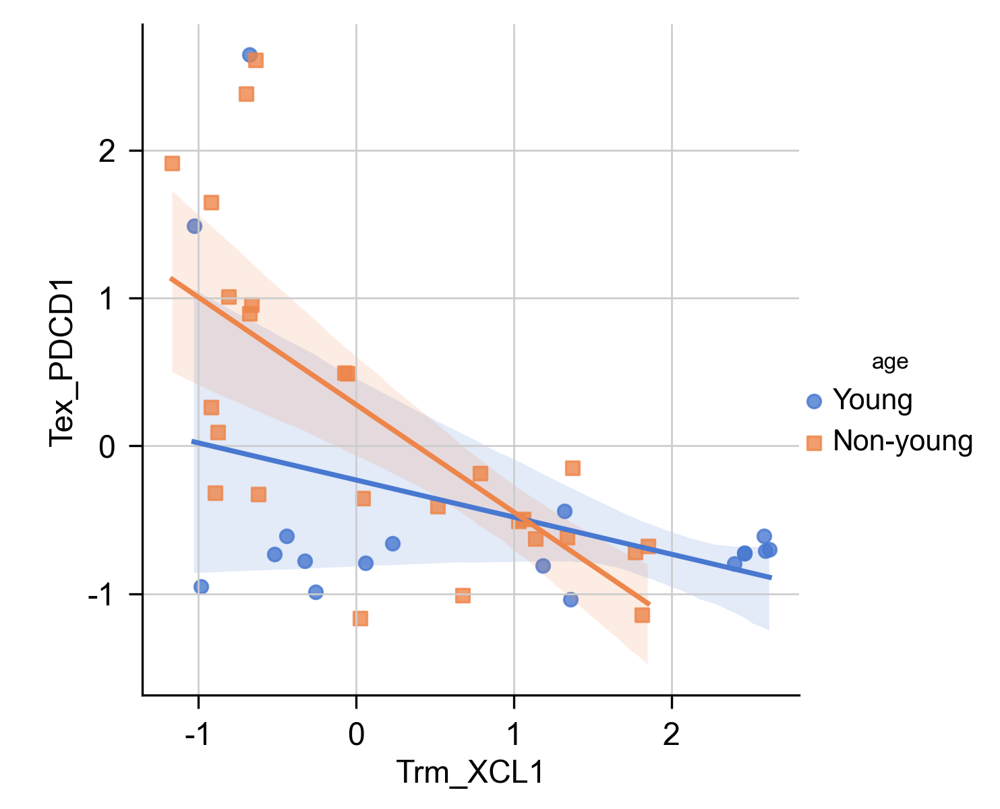

In [1114]:
import seaborn as sns

ax = sns.lmplot(x='Trm_XCL1', y='Tex_PDCD1', hue='age', data=total_df, logistic=False, markers=["o", "s"], palette="muted")
ax.fig.savefig("figure-1.23/S1d-reg.svg")

In [1009]:
sc.tl.rank_genes_groups(adata_CD8T_old, groupby='anno-CD8T')
sc.tl.filter_rank_genes_groups(adata_CD8T_old)
sc.tl.dendrogram(adata_CD8T_old, groupby='anno-CD8T')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 1, max_out_group_fraction: 0.5
    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_anno-CD8T']`


categories: C01_Trm_XCL1, C02_Trm_IL7R, C03_Trm_ISG15, etc.
var_group_labels: C03_Trm_ISG15


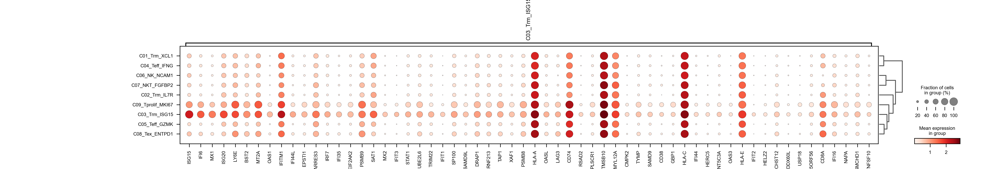

In [1013]:
sc.pl.rank_genes_groups_dotplot(adata_CD8T_old, groups=['C03_Trm_ISG15'], n_genes=60)

categories: C01_Trm_XCL1, C02_Trm_IL7R, C03_Trm_ISG15, etc.
var_group_labels: C01_Trm_XCL1


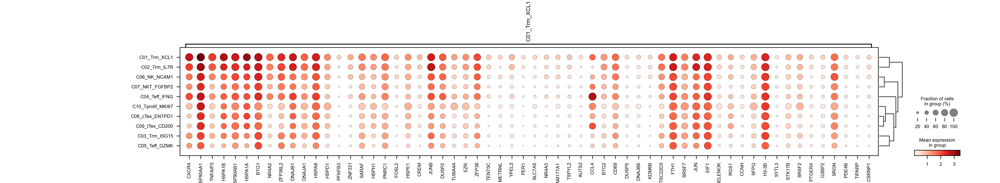

In [1011]:
sc.pl.rank_genes_groups_dotplot(adata_CD8T, groups=['C01_Trm_XCL1'], n_genes=60)

In [916]:
adata_CD8T_old.obs['cptype'] = adata_CD8T_old.obs['anno-CD8T']
adata_concat.obs['cptype'] = adata_concat.obs['annotation']
adata_epi_CD8T_old = adata_CD8T_old.concatenate(adata_concat[adata_concat.obs['age'] == 'Non-young'])
adata_epi_CD8T_old.obs_names_make_unique()
adata_epi_CD8T_old.write_h5ad("adata-epi-CD8T-old-2.11.h5ad")

In [915]:
ct = list(adata_CD8T_old.obs['anno-CD8T'].unique())
ct.sort()
ct_str = '|'.join(ct)
ct_str

'C01_Trm_XCL1|C02_Trm_IL7R|C03_Trm_ISG15|C04_Teff_IFNG|C05_Teff_GZMK|C06_NK_NCAM1|C07_NKT_FGFBP2|C08_Tex_ENTPD1|C09_Tprolif_MKI67'

In [917]:
meta = pd.DataFrame(adata_epi_CD8T_old.obs['cptype'].copy())
meta = meta.reset_index()
meta.columns=['Cell', 'cell_type']
meta.to_csv("meta.txt", sep='\t', index=False)
cpdb_res_em = cpdb_statistical_analysis_method.call(
  cpdb_file_path="cellphonedb.zip",
  meta_file_path="meta.txt",
  counts_file_path="adata-epi-CD8T-old-2.11.h5ad",
  counts_data='hgnc_symbol',
  output_path="cpdb",
  threads=16,
)

Reading user files...
The following user files were loaded successfully:
adata-epi-CD8T-old-2.11.h5ad
meta.txt
[ ][CORE][11/02/25-10:50:46][INFO] [Cluster Statistical Analysis] Threshold:0.1 Iterations:1000 Debug-seed:-1 Threads:16 Precision:3
[ ][CORE][11/02/25-10:50:48][INFO] Running Real Analysis
[ ][CORE][11/02/25-10:50:48][INFO] Running Statistical Analysis


100%|██████████| 1000/1000 [04:12<00:00,  3.96it/s]

[ ][CORE][11/02/25-10:55:01][INFO] Building Pvalues result


[ ][CORE][11/02/25-10:55:01][INFO] Building results
Saved deconvoluted to cpdb/statistical_analysis_deconvoluted_02_11_2025_105502.txt
Saved deconvoluted_percents to cpdb/statistical_analysis_deconvoluted_percents_02_11_2025_105502.txt
Saved means to cpdb/statistical_analysis_means_02_11_2025_105502.txt
Saved pvalues to cpdb/statistical_analysis_pvalues_02_11_2025_105502.txt
Saved significant_means to cpdb/statistical_analysis_significant_means_02_11_2025_105502.txt


In [918]:
adata_epi_CD8T_old.uns['CellphoneDB'] = cpdb_res_em
adata_epi_CD8T_old

AnnData object with n_obs × n_vars = 20796 × 17269
    obs: 'type', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mito', 'subtype', 'celltype_subset', 'celltype_minor', 'celltype_major', 'batch', 'mt_frac', 'n_genes', 'n_counts', 'doublet_score', 'predicted_doublet', 'leiden-1', 'UCell_B cells', 'UCell_B cells memory', 'UCell_B cells naive', 'UCell_Basophils', 'UCell_Dendritic cells', 'UCell_Eosinophils', 'UCell_Erythroblasts', 'UCell_Erythroid-like and erythroid precursor cells', 'UCell_Gamma delta T cells', 'UCell_Macrophages', 'UCell_Mast cells', 'UCell_Megakaryocytes', 'UCell_Monocytes', 'UCell_Myeloid-derived suppressor cells', 'UCell_NK cells', 'UCell_Natural killer T cells', 'UCell_Neutrophils', 'UCell_Nuocytes', 'UCell_Plasma cells', 'UCell_Plasmacytoid dendritic cells', 'UCell_Platelets', 'UCell_Red pulp macrophages', 'UCell_Reticulocytes', 'UCell_T cells', 'UCell_T cytotoxic cells', 'UCell_T follicular helper cells', 'UCell_T helper cells', 'UCell_T memory cells', 'UCe

In [920]:
ax = kpy.plot_cpdb(
  adata=adata_epi_CD8T_old,
  cell_type1="TNBC|HR+HER2-|HR+HER2+|HR-HER2+",
  cell_type2=ct_str,
  means=adata_epi_CD8T_old.uns['CellphoneDB']['means'],
  pvals=adata_epi_CD8T_old.uns['CellphoneDB']['pvalues'],
  genes=['CDH1', 'XCL', 'XCR'],
  celltype_key='cptype',
  max_size=4,
  max_highlight_size=1,
  highlight_size=0.75,
  degs_analysis=False,
  standard_scale=True,
  figsize=(15,5),
)
ax.save(f'figure-1.23/cpdb_et8_old.png', dpi=300)

In [926]:
adata_CD8T_old.obs['sample'] = adata_CD8T_old.obs['batch']
adata_CD8T.obs['sample'] = adata_CD8T.obs['batch']
adata_CD8T.obs['anno-CD8T'] = adata_CD8T.obs['anno-CD8T-har']

AAACCCAGTGGTAATA-1T          C02_Trm_IL7R
AAACGAAGTGCGAGTA-1T         C05_Teff_GZMK
AAACGAATCCGCTAGG-1T         C05_Teff_GZMK
AAAGAACAGCCGTTGC-1T         C03_Trm_ISG15
AAAGAACCAAACTGCT-1T          C02_Trm_IL7R
                              ...        
TTCTCCTCAATGGAGC-22T    C10_Tprolif_MKI67
TTGACTTCAGCTATTG-22T    C10_Tprolif_MKI67
TTGGCAAGTACGCACC-22T      C08_cTex_ENTPD1
TTTCCTCAGCCGGTAA-22T    C10_Tprolif_MKI67
TTTGGTTTCACCTCGT-22T      C08_cTex_ENTPD1
Name: anno-CD8T, Length: 27672, dtype: category
Categories (10, object): ['C01_Trm_XCL1', 'C02_Trm_IL7R', 'C03_Trm_ISG15', 'C04_Teff_IFNG', ..., 'C07_NKT_FGFBP2', 'C08_cTex_ENTPD1', 'C09_tTex_CD200', 'C10_Tprolif_MKI67']

In [927]:
adata_CD8T_all = adata_CD8T.concatenate(adata_CD8T_old)
adata_CD8T_all

AnnData object with n_obs × n_vars = 34881 × 18270
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix', 'leiden-T', 'leiden-Tmix', 'leiden-CD8T', 'anno-CD8T', 'sample', 'tech', 'ano-CD8T-har', 'anno-CD8T-har', 'cptype', 'type', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mito', 'subtype', 'celltype_subset', 'celltype_minor', 'celltype_major', 'leiden-1', 'UCell_B cells', 'UCell_B cells memory', 'UCell_B cells naive', 'UCell_Basophils', 'UCell_Dendritic cells', 'UCell_Eosinophils', 'UCell_Erythroblasts', 'UCell_Erythroid-like and erythroid precursor cells', 'UCell_Gamma delta T cells', 'UCell_Macrophages', 'UCell_Mast cells', 'UCell_Megakaryocytes', 'UCell_Monocyt

normalizing counts per cell
    finished (0:00:00)
Ignoring processing doublet cells...
If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:38)


2025-02-11 12:44:56,635 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-02-11 12:45:36,390 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-02-11 12:45:36,632 - harmonypy - INFO - Iteration 1 of 20
2025-02-11 12:45:50,736 - harmonypy - INFO - Iteration 2 of 20
2025-02-11 12:46:01,558 - harmonypy - INFO - Iteration 3 of 20
2025-02-11 12:46:09,012 - harmonypy - INFO - Iteration 4 of 20
2025-02-11 12:46:16,534 - harmonypy - INFO - Iteration 5 of 20
2025-02-11 12:46:22,121 - harmonypy - INFO - Iteration 6 of 20
2025-02-11 12:46:26,165 - harmonypy - INFO - Iteration 7 of 20
2025-02-11 12:46:29,501 - harmonypy - INFO - Iteration 8 of 20
2025-02-11 12:46:32,437 - harmonypy - INFO - Iteration 9 of 20
2025-02-11 12:46:35,372 - harmonypy - INFO - Iteration 10 of 20
2025-02-11 12:46:38,277 - harmonypy - INFO - Iteration 11 of 20
2025-02-11 12:46:40,872 - harmonypy - INFO - Iteration 12 of 20
2025-02-11 12:46:43,502 - harmonypy - INFO - Iteration 13 of

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:15)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:40)
running Leiden clustering
    finished: found 13 clusters and added
    'leiden-CD8T', the cluster labels (adata.obs, categorical) (0:01:08)


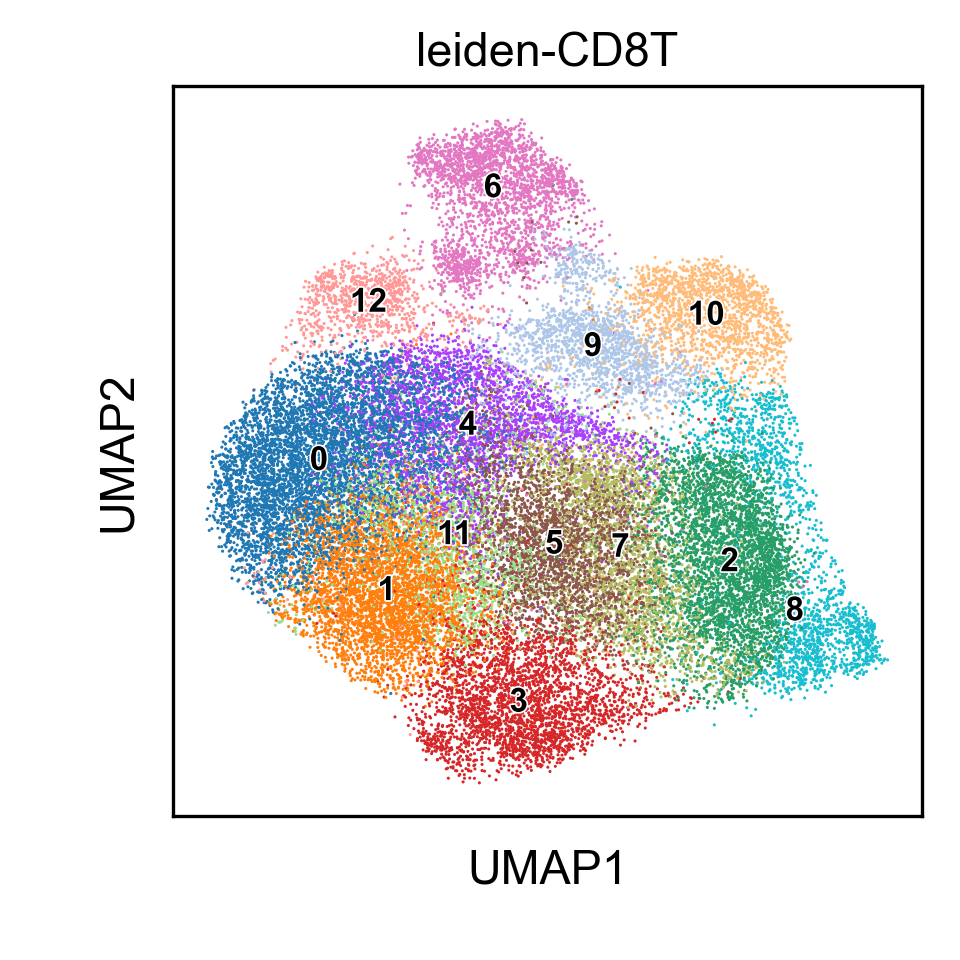

AnnData object with n_obs × n_vars = 34881 × 18270
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix', 'leiden-T', 'leiden-Tmix', 'leiden-CD8T', 'anno-CD8T', 'sample', 'tech', 'ano-CD8T-har', 'anno-CD8T-har', 'cptype', 'type', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mito', 'subtype', 'celltype_subset', 'celltype_minor', 'celltype_major', 'leiden-1', 'UCell_B cells', 'UCell_B cells memory', 'UCell_B cells naive', 'UCell_Basophils', 'UCell_Dendritic cells', 'UCell_Eosinophils', 'UCell_Erythroblasts', 'UCell_Erythroid-like and erythroid precursor cells', 'UCell_Gamma delta T cells', 'UCell_Macrophages', 'UCell_Mast cells', 'UCell_Megakaryocytes', 'UCell_Monocyt

In [929]:
sc.pp.normalize_total(adata_CD8T_all)
sc.pp.log1p(adata_CD8T_all)
adata_CD8T_all = clu(adata_CD8T_all, 'leiden-CD8T', do_har=True)
adata_CD8T_all

In [1161]:
cytogenes = ['PRF1', 'GZMA', 'GZMB', 'GNLY', 'NKG7', 'GZMK', 'IFNG', 'TNFAIP3', 'IL2RA', 'GZMH', 'ITGAL', 'ITGB2']
exgenes = ['PDCD1', 'HAVCR2', 'TIGIT', 'CTLA4', 'LAG3']
sc.tl.score_genes(adata_CD8T_all, gene_list=exgenes, score_name='exhaustion')

computing score 'exhaustion'
    finished: added
    'exhaustion', score of gene set (adata.obs).
    250 total control genes are used. (0:00:01)


In [1040]:
manadf = adata_CD8T[:, ['CXCL13', 'ENTPD1', 'IL7R']].X.toarray()
manadf = pd.DataFrame(manadf, index=adata_CD8T.obs_names, columns=['CXCL13', 'ENTPD1', 'IL7R'])
manadf.to_csv('manadf.csv')

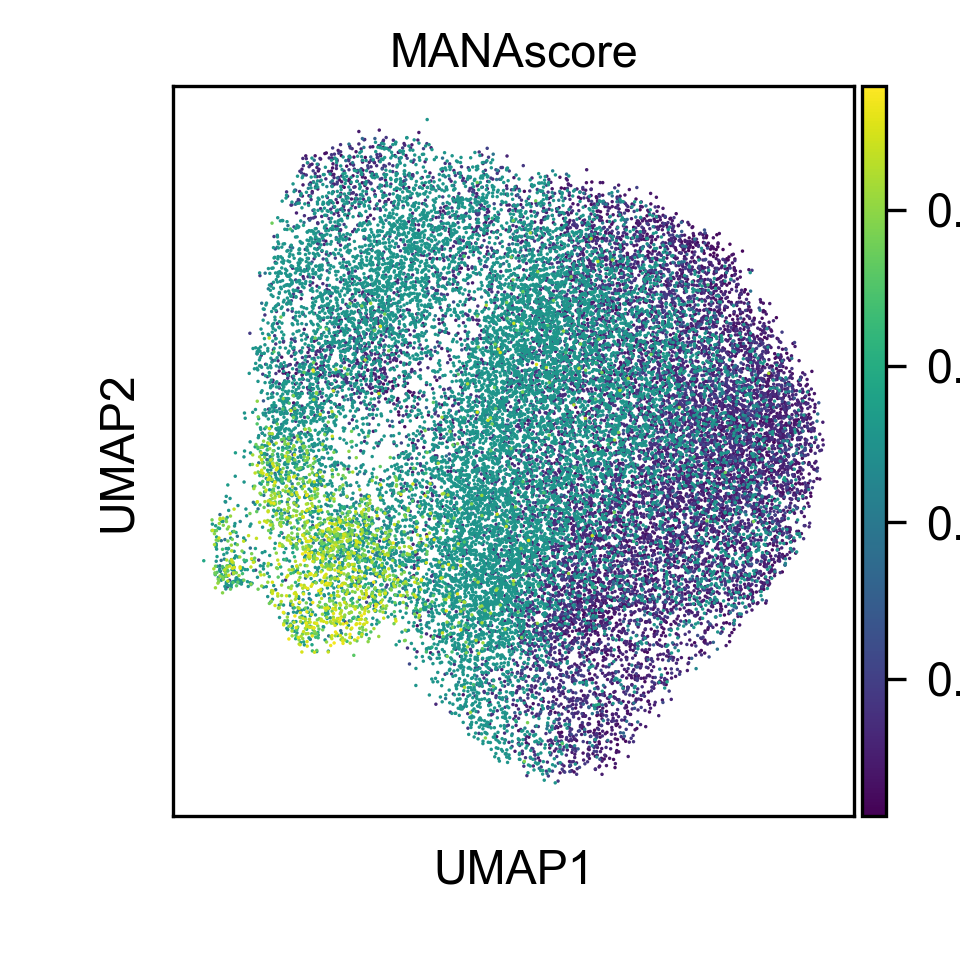

In [1050]:
adata_CD8T.obs['MANAscore'] = pd.read_csv('manaout2.csv', sep=',', index_col=0)
sc.pl.umap(adata_CD8T, color=['MANAscore'])

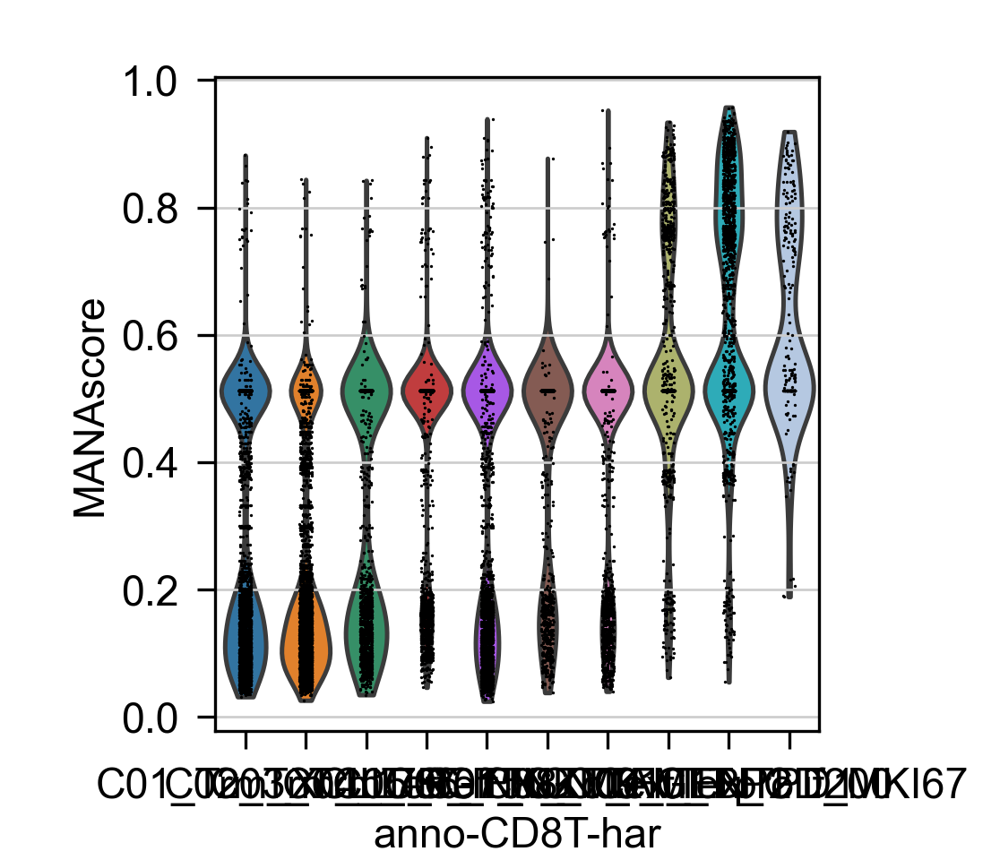

In [1051]:
sc.pl.violin(adata_CD8T, keys='MANAscore', groupby='anno-CD8T-har')

In [ ]:
adata_CD4T

AnnData object with n_obs × n_vars = 17949 × 41733
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix', 'leiden-T', 'sample', 'leiden-Tmix', 'leiden-CD4T', 'tech', 'anno-CD4T', 'cptype'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'leiden-T_colors', 'hvg', 'pca', 'neighbors', 'umap', 'leiden', 'leiden-CD4T_colors', 'batch_colors', 'sample_colors', 'rank_genes_groups', 'dendrogram_leiden-CD4T', 'anno-CD4T_colors', 'dendrogram_anno-CD4T'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    obsp: 'di

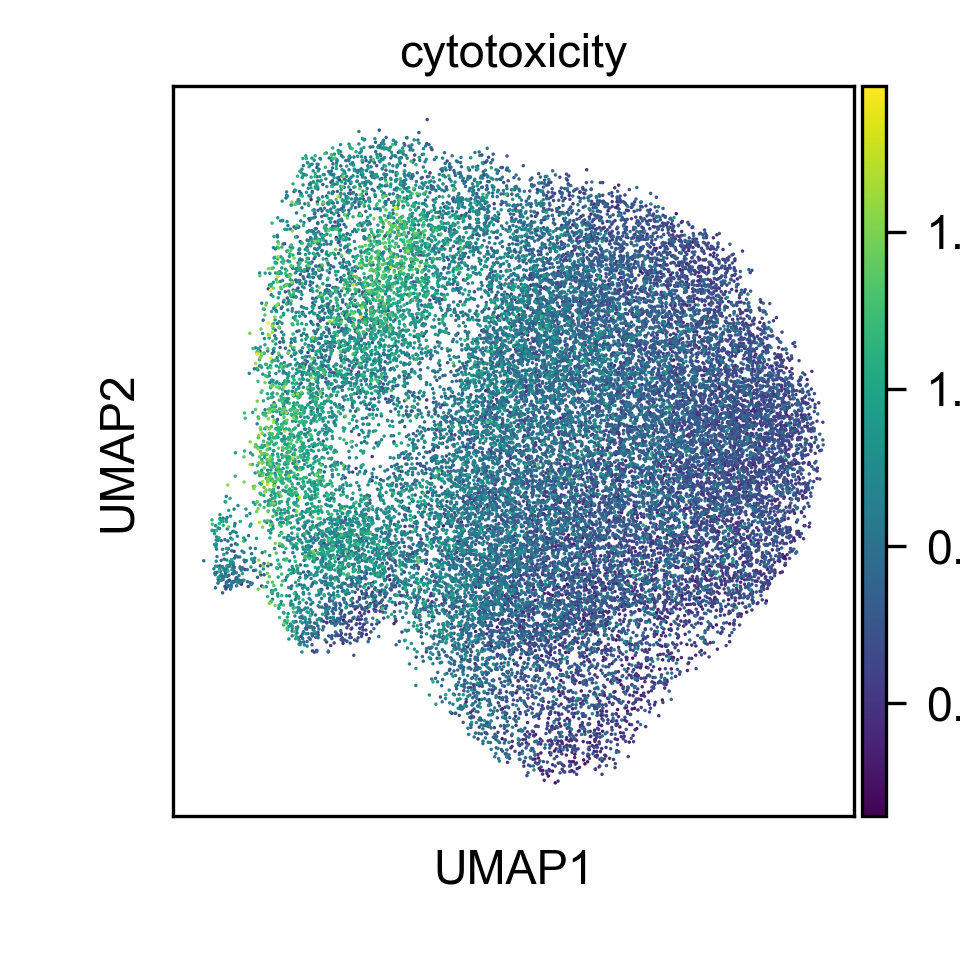

In [1035]:
sc.pl.umap(adata_CD8T, color=['cytotoxicity'])

In [937]:
adata_CD8T_all[:, 'KLRG1'].X.toarray().flatten()

array([0.   , 0.   , 1.393, ..., 0.   , 0.   , 0.   ], dtype=float32)

In [941]:
df = pd.DataFrame(adata_CD8T_all.obs[['batch','anno-CD8T']])

In [1016]:
df['XCL2'] = adata_CD8T_all[:, 'XCL2'].X.toarray().flatten()
df

,batch,anno-CD8T,KLRG1,XCL1,CXCR4,XCL2
AAACCCAGTGGTAATA-1T-0,0,C02_Trm_IL7R,0.000000,0.000000,1.184971,0.000000
AAACGAAGTGCGAGTA-1T-0,0,C05_Teff_GZMK,0.000000,0.000000,0.000000,0.000000
AAACGAATCCGCTAGG-1T-0,0,C05_Teff_GZMK,1.392571,0.000000,1.605189,0.000000
AAAGAACAGCCGTTGC-1T-0,0,C03_Trm_ISG15,0.000000,0.000000,0.000000,0.000000
AAAGAACCAAACTGCT-1T-0,0,C02_Trm_IL7R,0.000000,0.000000,1.383182,0.000000
...,...,...,...,...,...,...
CID45171_GGTGTTAGTATCACCA-CID45171-1,1,C08_Tex_ENTPD1,0.000000,0.000000,1.204343,1.204343
CID44971_GGACGTCAGCCATCGC-CID44971-1,1,C08_Tex_ENTPD1,0.000000,0.000000,0.000000,0.000000
CID4290A_GCACATATCACTCTTA-CID4290A-1,1,C04_Teff_IFNG,0.000000,0.000000,1.992353,0.000000
CID3963_ACAGCCGAGACAGAGA-CID3963-1,1,C05_Teff_GZMK,0.000000,0.000000,1.022636,0.000000


In [944]:
import seaborn as sns

[Text(0, 0, 'Young'), Text(1, 0, 'Non-young')]

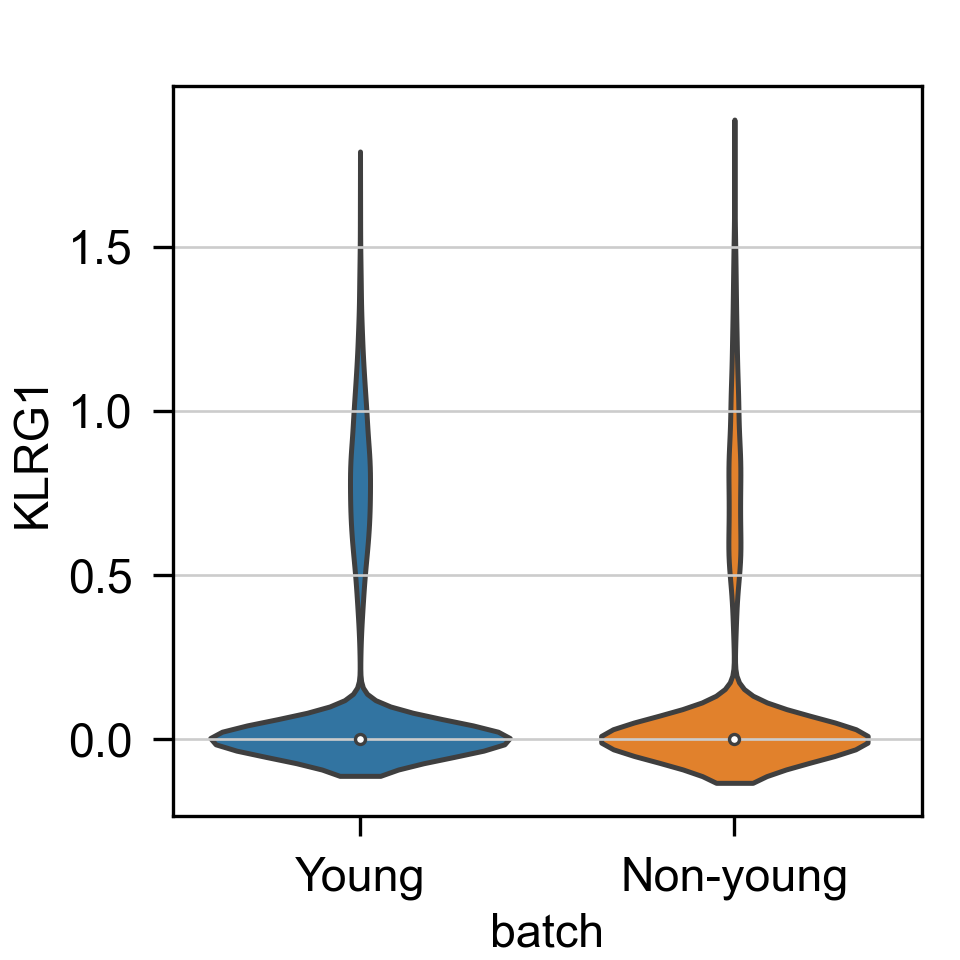

In [956]:
ax = sns.violinplot(x='batch', y='KLRG1', data=df[df['anno-CD8T'].isin(['C04_Teff_IFNG', 'C05_Teff_GZMK', 'C07_NKT_FGFBP2'])])
ax.set_xticklabels(['Young', 'Non-young'])

[Text(0, 0, 'Young'), Text(1, 0, 'Non-young')]

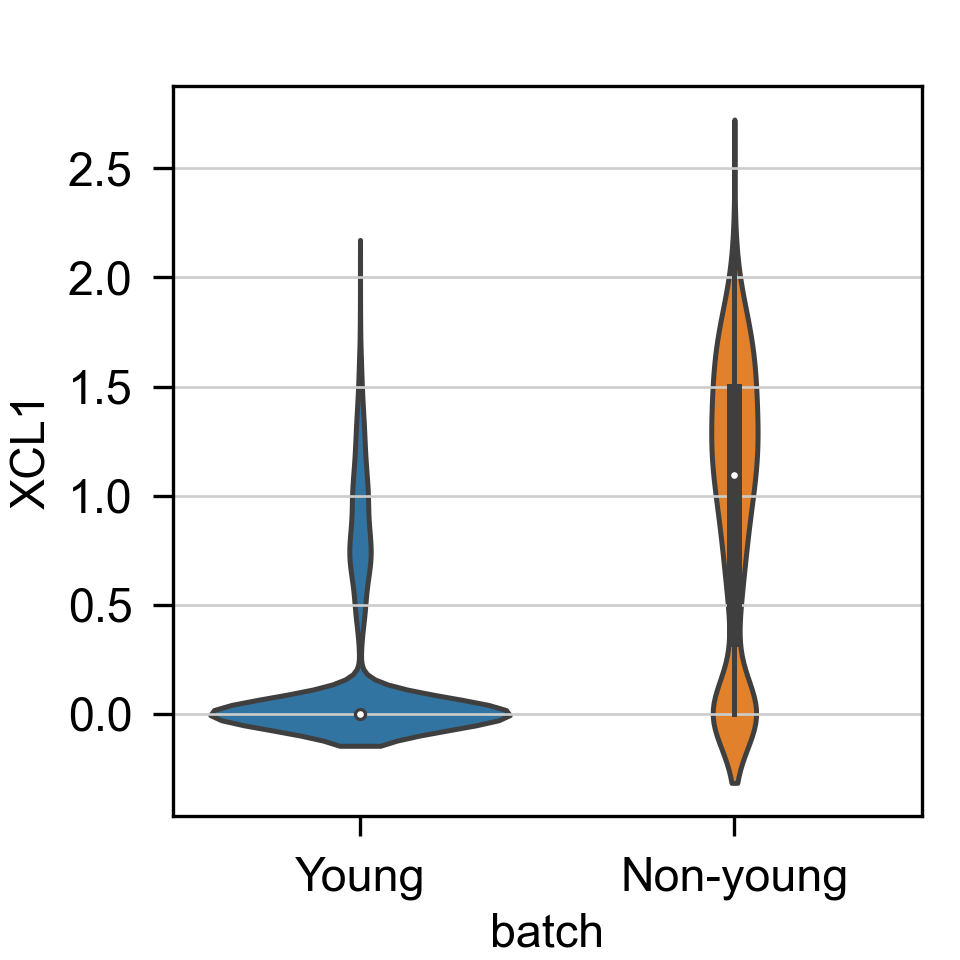

In [957]:
ax = sns.violinplot(x='batch', y='XCL1', data=df[df['anno-CD8T'].isin(['C01_Trm_XCL1'])])
ax.set_xticklabels(['Young', 'Non-young'])

[Text(0, 0, 'Young'), Text(1, 0, 'Non-young')]

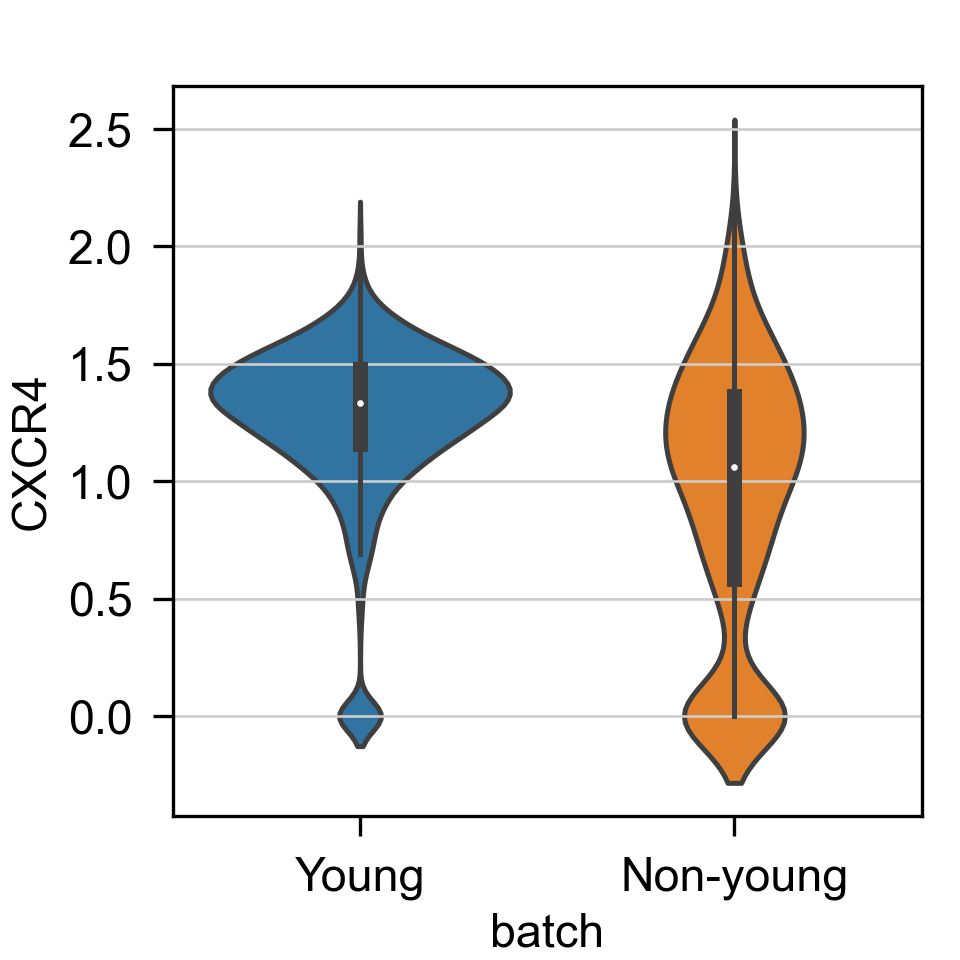

In [1015]:
ax = sns.violinplot(x='batch', y='CXCR4', data=df[df['anno-CD8T'].isin(['C01_Trm_XCL1'])])
ax.set_xticklabels(['Young', 'Non-young'])

In [1171]:
import scipy.stats as stats
data = df[df['anno-CD8T'].isin(['C01_Trm_XCL1'])]
def DEplot(data, gene, group='batch'):
  ax = sns.violinplot(x=group, y=gene, data=data)
  t_stat, pval = stats.ttest_ind(data[data.batch == '0'][gene],
                                data[data.batch == '1'][gene], equal_var=False, )
  if pval < 0.001:
    star = '***'
  elif pval < 0.01:
    star = '**'
  elif pval < 0.05:
    star = '*'
  else:
    star = 'ns'
  ax.set_xticklabels(['Young', 'Non-young'])
  ax.text(0, max(data[gene]), f"p = {pval:.3f}\n{star}", fontsize=12, horizontalalignment='center')

def DEplot_adata(adata, gene, ax, group='batch'):
  sns.set_style("ticks")
  data = adata_CD8T_all.obs[[gene, group]]
  sns.boxplot(data=data, x=group, y=gene, fliersize=0, width=.6,
                  palette=['#66b9b4', '#005292'],saturation=0.4, ax=ax)
  sample_data = data.sample(n=1000, random_state=42)
  sns.stripplot(data=sample_data, x=group, y=gene, 
                color='.5', size=3, ax=ax, marker='o', alpha=.5)
  t_stat, pval = stats.ttest_ind(adata.obs.loc[adata.obs[group] == '0', gene],
                                adata.obs.loc[adata.obs[group] == '1', gene], equal_var=False, )
  if pval < 0.001:
    star = '***'
  elif pval < 0.01:
    star = '**'
  elif pval < 0.05:
    star = '*'
  else:
    star = 'ns'
  ax.set_ylim(min(adata.obs[gene])-0.05, max(adata.obs[gene]+0.15))
  ax.set_xticklabels(['Young', 'Non-young'])
  sns.lineplot(x=[0, 1], y=max(adata.obs[gene]), color='black', linewidth=1.2)
  ax.text(0.5, max(adata.obs[gene]), f"p = {pval:.3f}\n{star}", fontsize=12, horizontalalignment='center')
  ax.spines['top'].set_visible(False)
  ax.spines['right'].set_visible(False)
  return ax

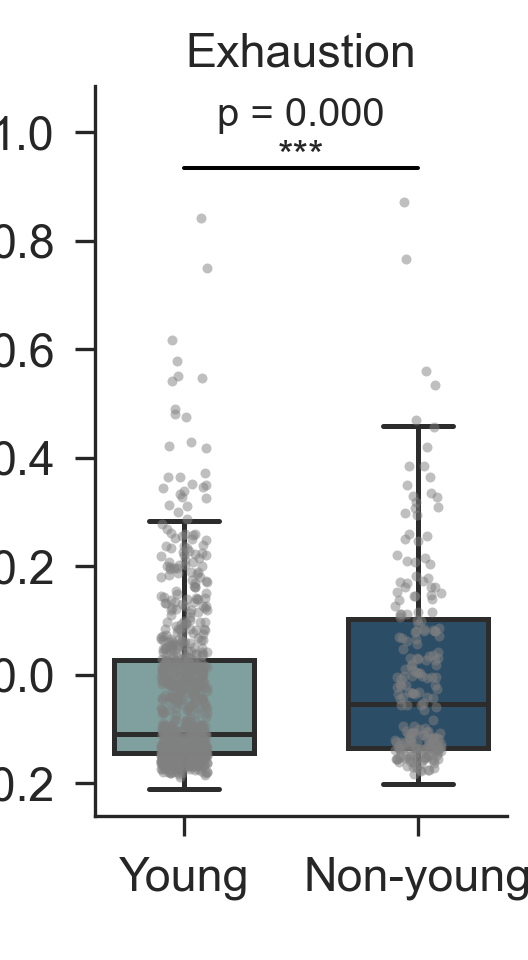

In [1172]:
fig, ax = plt.subplots(1, 1, figsize=(2.2, 4))
ax = DEplot_adata(adata_CD8T_all[~adata_CD8T_all.obs['anno-CD8T'].isin(['C06_NK_NCAM1', 'C07_NKT_FGFBP2'])], gene='exhaustion', ax=ax, group='batch')
ax.set_title('Exhaustion')
ax.set_ylabel('Scaled enrichment score')
ax.set_xlabel('')
fig.savefig("figure-1.23/S1e-exhaustion1.svg",bbox_inches='tight')

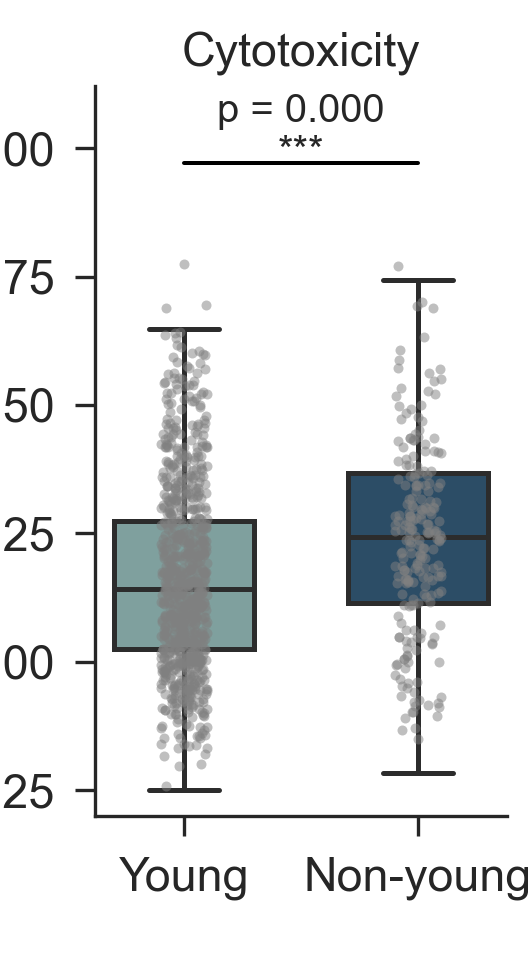

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(2.2, 4))
ax = DEplot_adata(adata_CD8T_all[~adata_CD8T_all.obs['anno-CD8T'].isin(['C06_NK_NCAM1', 'C07_NKT_FGFBP2'])], gene='cytotoxicity', ax=ax, group='batch')
ax.set_title('Cytotoxicity')
ax.set_ylabel('Scaled enrichment score')
ax.set_xlabel('')
fig.savefig("figure-1.23/S1e-cytotoxicity1.svg",bbox_inches='tight')

In [ ]:
adata_CD8T_all.obs['anno-CD8T'].cat.categories

Index(['C01_Trm_XCL1', 'C02_Trm_IL7R', 'C03_Trm_ISG15', 'C04_Teff_IFNG',
       'C05_Teff_GZMK', 'C06_NK_NCAM1', 'C07_NKT_FGFBP2', 'C08_Tex_ENTPD1',
       'C08_cTex_ENTPD1', 'C09_Tprolif_MKI67', 'C09_tTex_CD200',
       'C10_Tprolif_MKI67'],
      dtype='object')

In [1372]:
adata_CD4T_old

AnnData object with n_obs × n_vars = 10333 × 21864
    obs: 'type', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mito', 'subtype', 'celltype_subset', 'celltype_minor', 'celltype_major', 'batch', 'mt_frac', 'n_genes', 'n_counts', 'doublet_score', 'predicted_doublet', 'leiden-1', 'UCell_B cells', 'UCell_B cells memory', 'UCell_B cells naive', 'UCell_Basophils', 'UCell_Dendritic cells', 'UCell_Eosinophils', 'UCell_Erythroblasts', 'UCell_Erythroid-like and erythroid precursor cells', 'UCell_Gamma delta T cells', 'UCell_Macrophages', 'UCell_Mast cells', 'UCell_Megakaryocytes', 'UCell_Monocytes', 'UCell_Myeloid-derived suppressor cells', 'UCell_NK cells', 'UCell_Natural killer T cells', 'UCell_Neutrophils', 'UCell_Nuocytes', 'UCell_Plasma cells', 'UCell_Plasmacytoid dendritic cells', 'UCell_Platelets', 'UCell_Red pulp macrophages', 'UCell_Reticulocytes', 'UCell_T cells', 'UCell_T cytotoxic cells', 'UCell_T follicular helper cells', 'UCell_T helper cells', 'UCell_T memory cells', 'UCe

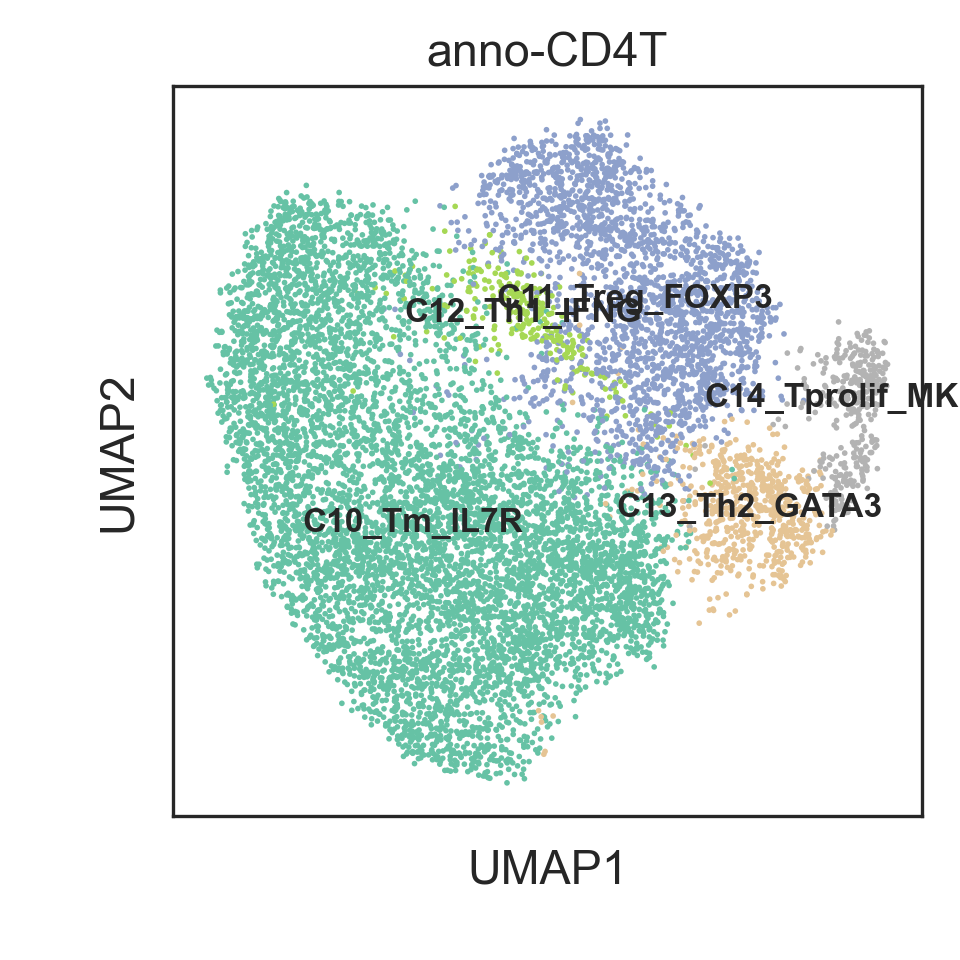

In [1374]:
sc.pl.umap(adata_CD4T_old, color=['anno-CD4T'], legend_loc='on data')

In [1181]:
del adata_CD4T_old.uns['rank_genes_groups_filtered']

In [1182]:
adata_CD4T_old.write_h5ad("adata-CD4T-old-1.26.h5ad")

### Run DA using miloR

In [ ]:
# adata.obs['majorType-fix'].cat.categories
annoDict = {
  'Non-tumoral': ['5N', '6N', '10N', '12N', '16N'],
  'TNBC': ['1T', '2T', '3T', '8T', '9T',],
  'HR+HER2-': ['5T', '6T', '10T', '15T', ],
  'HR+HER2+': ['20T', '21T', '22T',],
  'HR-HER2+': ['17T', ],
}
adata = anno(adata, annoDict, 'IHC', 'batch')
adata_B = adata[adata.obs['majorType-fix'].isin(['B cells', 'Plasmablast'])]
adata_B

Index(['B cells', 'Endothelial', 'Epithelial', 'Fibroblast', 'Mast', 'Myeloid',
       'PeriVascular', 'Plasmablast', 'T cells'],
      dtype='object')

View of AnnData object with n_obs × n_vars = 8561 × 41733
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix', 'IHC'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'CellphoneDB', 'batch_colors', 'dendrogram_leiden', 'epi-subtype_colors', 'gender_colors', 'hvg', 'leiden', 'leiden-harmony-female_colors', 'leiden_colors', 'leiden_harmony_colors', 'log1p', 'majorType-Female_colors', 'majorType-fix_colors', 'major_type_colors', 'major_type_harmony_colors', 'minor-type_colors', 'minor_type_colors', 'neighbors', 'pca'

In [ ]:
adata_B.write_h5ad("adata-B-3.14.h5ad")

In [ ]:
'KIR3DL1' in adata.var_names

True

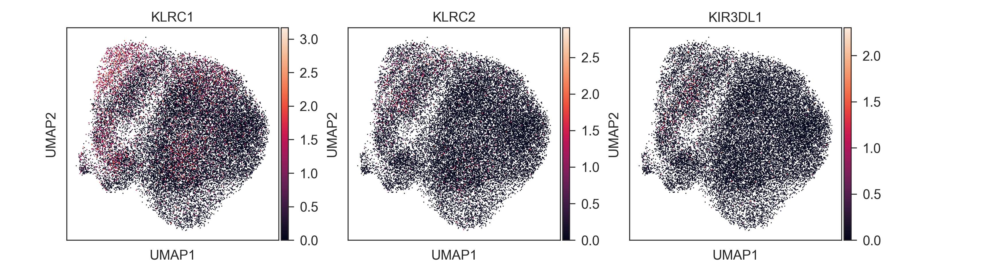

In [ ]:
sc.pl.umap(adata_CD8T, color=['KLRC1', 'KLRC2', 'KIR3DL1'])

In [ ]:
import memento
import anndata as ad
import pandas as pd
def DE_memento_1d(adata: ad.AnnData, ctleft: list, ctright: list, groupby='annotation'):
  _adata = adata[adata.obs[groupby].isin(ctleft + ctright)].copy()
  _adata.obs['stim'] = _adata.obs[groupby].isin(ctright)
  _adata.obs['stim'] = _adata.obs['stim'].astype('int')
  _adata.obs['capture_rate'] = 0.07
  memento.setup_memento(_adata, q_column='capture_rate')
  memento.create_groups(_adata, label_columns=['stim'])
  memento.compute_1d_moments(_adata, min_perc_group=.7)
  meta_df = memento.get_groups(_adata)
  meta_df['intercept'] = 1
  convariate = meta_df[['intercept']]
  treatment = (meta_df[['stim']] == 1).astype(float)
  
  memento.ht_1d_moments(_adata,
  covariate=convariate,
  treatment=treatment,
  num_cpus=16,
  resample_rep=False,
  )
  memento_results = memento.get_1d_ht_result(_adata)
  return(memento_results)